<a href="https://colab.research.google.com/github/giangdip2410/Research-Stuff/blob/main/CPSC5440_Assigment2_JGM667.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Library

In [ ]:
import warnings
warnings.filterwarnings("ignore")
try:
  from pytorch_model_summary import summary
  from torchviz import make_dot
  from einops.layers.torch import Rearrange, Reduce
  import talos
  
except:
  !pip install talos -q
  !pip install torchviz -q
  !pip install pytorch-model-summary -q
  !pip install einops -q
  !pip install torchmetrics -q
  from pytorch_model_summary import summary
  from torchviz import make_dot
  from einops.layers.torch import Rearrange, Reduce
  import talos
  from torchmetrics import HingeLoss
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data
from torch import nn, einsum
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import Dataset, DataLoader
from sklearn import metrics,decomposition,manifold
from sklearn.model_selection import train_test_split
from tqdm.notebook import trange, tqdm
import matplotlib.pyplot as plt
import numpy as np
import os
import copy
import random
import time
import pickle
from functools import partial
import pandas as pd

In [ ]:
#fix seed
SEED = 42

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

### Prepare Data

In [ ]:
#data root folder
ROOT = 'data/assignment_2'
# read train pickle file
with open(f'{ROOT}/train', 'rb') as file:
    train_dict = pickle.load(file, encoding='bytes')
# read test pickle file
with open(f'{ROOT}/test', 'rb') as file:
    test_dict = pickle.load(file, encoding='bytes')
# get train and test feature, label
X_train, y_train = train_dict[b'data'],train_dict[b'coarse_labels']
X_test, y_test = test_dict[b'data'], test_dict[b'coarse_labels']
print("Training sample: ",X_train.shape)
print("Testing sample: ",X_test.shape)
#number of labels
number_classes = len(set(y_train))
print("Number of classes: ",number_classes)

Training sample:  (50000, 3072)
Testing sample:  (10000, 3072)
Number of classes:  20


In [ ]:
#reshape feature to image present
X_train = np.array(X_train.reshape(-1 ,3, 32, 32),dtype=np.uint8).transpose(0, 2, 3, 1)
X_test = np.array(X_test.reshape(-1 ,3, 32, 32),dtype=np.uint8).transpose(0, 2, 3, 1)

In [ ]:
#normalize data
mean_rgb, std_rgb = [], []
for i in range(3):
  mean = X_train[:,:,:,i].mean() / 255
  mean_rgb.append(mean)
  std = X_train[:,:,:,i].std() / 255
  std_rgb.append(std)
print(f'Calculated mean: {mean_rgb}')
print(f'Calculated std: {std_rgb}')

Calculated mean: [0.5070751592371323, 0.48654887331495095, 0.4409178433670343]
Calculated std: [0.2673342858792409, 0.25643846291708816, 0.2761504713256834]


In [ ]:
# transform data
train_transforms = transforms.Compose([
                            transforms.ToPILImage(),
                            transforms.RandomRotation(5),
                            transforms.RandomCrop(32, padding=2),
                            transforms.ToTensor(),
                            transforms.Normalize(mean=mean_rgb, std=std_rgb)
                                      ])

test_transforms = transforms.Compose([
                           transforms.ToPILImage(),
                           transforms.ToTensor(),
                           transforms.Normalize(mean=mean_rgb, std=std_rgb)
                                     ])

In [ ]:
#dataset class
class Cifar100(Dataset):
    def __init__(self, X, y , transform):
        super().__init__()
        self.X = X
        self.y = torch.from_numpy(np.array(y)).long()
        self.transform  = transform
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        X_batch = self.X[idx]
        # augmentations
        if self.transform:
            X_batch = self.transform(X_batch)
            X_batch = X_batch.permute(1, 2, 0)
        if self.y is not None:
            y_batch = self.y[idx]
            return X_batch, y_batch     
        return X_batch

In [ ]:
#create dataset
train_data = Cifar100(X = X_train, y = y_train,transform = train_transforms)

test_data = Cifar100(X = X_test, y = y_test, transform = test_transforms)
#print information data
print(f'Number of training examples: {len(train_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 50000
Number of testing examples: 10000


In [ ]:
#plot image 
def plot_images(images):
    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize=(20, 15))
    for i in range(rows*cols):
        ax = fig.add_subplot(rows, cols, i+1)
        ax.imshow(images[i].cpu().numpy(), cmap='bone')
        ax.axis('off')

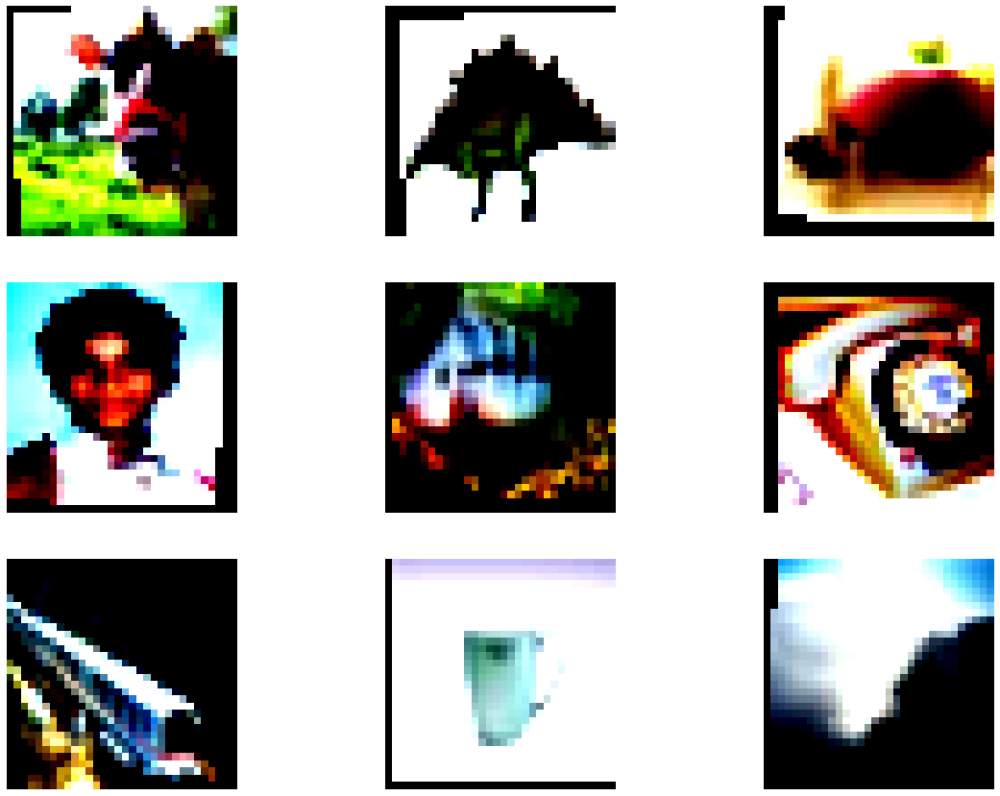

In [ ]:
#sample plot
N_IMAGES = 9

images = [image for image, label in [train_data[i] for i in range(N_IMAGES)]]

plot_images(images)

In [ ]:
#valid ratio 
VALID_RATIO = 0.9

n_train_examples = int(len(train_data) * VALID_RATIO)
n_valid_examples = len(train_data) - n_train_examples
#train val split
train_data, valid_data = data.random_split(train_data,
                                           [n_train_examples, n_valid_examples])
Xtrain, Xval, ytrain, yval = train_test_split(X_train, y_train, test_size=VALID_RATIO, stratify=y_train,random_state=SEED)
print(f'Number of training examples: {len(train_data)}')
print(f'Number of validation examples: {len(valid_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 45000
Number of validation examples: 5000
Number of testing examples: 10000


In [ ]:
#data loader for train/val/test
BATCH_SIZE = 64

train_iterator = data.DataLoader(train_data,
                                 shuffle=True,
                                 batch_size=BATCH_SIZE)

valid_iterator = data.DataLoader(valid_data,
                                 batch_size=BATCH_SIZE)

test_iterator = data.DataLoader(test_data,
                                batch_size=BATCH_SIZE)

#Build Deep Learning Model

#### MLP Base

In [ ]:
# create MLP model for RGB Image
class MLPRGB(nn.Module):
    def __init__(self, input_dim, output_dim, units=64, act_fun=F.relu):
        super().__init__()
        self.act_fun = act_fun
        self.input_fc = nn.Linear(input_dim, units)
        self.hidden1 = nn.Linear(units, units)
        self.hidden2 = nn.Linear(units, units)
        self.hidden3 = nn.Linear(units, units)
        self.hidden4 = nn.Linear(units, units)
        self.hidden5 = nn.Linear(units, units)
        self.output_fc = nn.Linear(units, output_dim)

    def forward(self, x):
        # x = [batch size, height, width,chanel]
        batch_size = x.shape[0]
        x = x.view(batch_size, -1)
        # input layer
        h_1 = self.input_fc(x)
        h_1 = self.act_fun(h_1)
        # 1st hidden layer
        h_2 = self.hidden1(h_1)
        h_2 = self.act_fun(h_2)
        # 2nd hidden layer
        h_3 = self.hidden1(h_2)
        h_3 = self.act_fun(h_3)
        # 3rd hidden layer
        h_4 = self.hidden1(h_3)
        h_4 = self.act_fun(h_4)
        # 4th hidden layer
        h_5 = self.hidden1(h_4)
        h_5 = self.act_fun(h_5)
        # 5th hidden layer
        h_6 = self.hidden1(h_5)
        h_6 = self.act_fun(h_6)
        # output
        y_pred = self.output_fc(h_6)
        return y_pred

In [ ]:
# create MLP model using MLP + Dropout
class MLPGRAY(nn.Module):
    def __init__(self, input_dim, output_dim, units=64, act_fun=F.relu):
        super().__init__()
        self.act_fun = act_fun
        self.dropout = nn.Dropout(p=0.19)
        self.input_fc = nn.Linear(input_dim, units)
        self.hidden1 = nn.Linear(units, units)
        self.hidden2 = nn.Linear(units, units)
        self.hidden3 = nn.Linear(units, units)
        self.hidden4 = nn.Linear(units, units)
        self.hidden5 = nn.Linear(units, units)
        self.output_fc = nn.Linear(units, output_dim)

    def forward(self, x):
        # x = [batch size, height, width, chanel]
        batch_size = x.shape[0]
        x = x.view(batch_size, -1)
        # input layer
        h_1 = self.input_fc(x)
        h_1 = self.act_fun(h_1)
        # 1st hidden layer
        h_2 = self.hidden1(h_1)
        h_2 = self.act_fun(h_2)
        h_2 = self.dropout(h_2)
        # 2nd hidden layer
        h_3 = self.hidden1(h_2)
        h_3 = self.act_fun(h_3)
        h_3 = self.dropout(h_3)
        # 3rd hidden layer
        h_4 = self.hidden1(h_3)
        h_4 = self.act_fun(h_4)
        h_4 = self.dropout(h_4)
        # 4th hidden layer
        h_5 = self.hidden1(h_4)
        h_5 = self.act_fun(h_5)
        h_5 = self.dropout(h_5)
        # 5th hidden layer
        h_6 = self.hidden1(h_5)
        h_6 = self.act_fun(h_6)
        h_6 = self.dropout(h_6)
        # output
        y_pred = self.output_fc(h_6)
        return y_pred

#### ResMLP

In [ ]:
#support classes
def pair(val):
    return (val, val) if not isinstance(val, tuple) else val

# classes

class Affine(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.g = nn.Parameter(torch.ones(1, 1, dim))
        self.b = nn.Parameter(torch.zeros(1, 1, dim))

    def forward(self, x):
        return x * self.g + self.b

class PreAffinePostLayerScale(nn.Module): # https://arxiv.org/abs/2103.17239
    def __init__(self, dim, depth, fn):
        super().__init__()
        if depth <= 18:
            init_eps = 0.1
        elif depth > 18 and depth <= 24:
            init_eps = 1e-5
        else:
            init_eps = 1e-6

        scale = torch.zeros(1, 1, dim).fill_(init_eps)
        self.scale = nn.Parameter(scale)
        self.affine = Affine(dim)
        self.fn = fn

    def forward(self, x):
        return self.fn(self.affine(x)) * self.scale + x

In [ ]:
#MLP model with idea from paper ResMLP: Feedforward networks for image classification with data-efficient training: https://arxiv.org/pdf/2105.03404.pdf
class ResMLP(nn.Module):
  def __init__(self, input_dim, output_dim, act_fun=nn.GELU()):
    super().__init__()
    self.patch_size = 4
    self.num_patches = (input_dim // self.patch_size) * (input_dim // self.patch_size)
    self.dim = 128
    self.wrapper = lambda i, fn: PreAffinePostLayerScale(self.dim, i + 1, fn)
    self.rearrange = Rearrange('b (h p1) (w p2) c -> b (h w) (p1 p2 c)', p1 = self.patch_size, p2 = self.patch_size)
    self.ln1 = nn.Linear((self.patch_size ** 2) * 3, self.dim)
    self.patching = self.wrapper(0, nn.Conv1d(self.num_patches, self.num_patches, 1))
    self.ln2 =  self.wrapper(i, nn.Sequential(
                nn.Linear(self.dim, self.dim*2),
                act_fun,
                nn.Linear(self.dim*2, self.dim)))
    self.ln3 = nn.Sequential(Affine(self.dim),Reduce('b n c -> b c', 'mean'),nn.Linear(self.dim, output_dim))
  
  def forward(self, x):
    x = self.rearrange(x)
    h1 = self.ln1(x)
    h2 = self.patching(h1)
    h3 = self.ln2(h2)
    pred = self.ln3(h3)
    return pred

In [ ]:
# create model
INPUT_DIM = 32
OUTPUT_DIM = number_classes

model = ResMLP(INPUT_DIM, OUTPUT_DIM)

In [ ]:
#number of params pytorch model
input_sample =  torch.zeros((1, 32, 32, 3))
print(summary(model, input_sample, show_input=True))

---------------------------------------------------------------------------------
                Layer (type)         Input Shape         Param #     Tr. Param #
                 Rearrange-1      [1, 32, 32, 3]               0               0
                    Linear-2         [1, 64, 48]           6,272           6,272
   PreAffinePostLayerScale-3        [1, 64, 128]           4,544           4,544
   PreAffinePostLayerScale-4        [1, 64, 128]          66,304          66,304
                    Affine-5        [1, 64, 128]             256             256
                    Reduce-6        [1, 64, 128]               0               0
                    Linear-7            [1, 128]           2,580           2,580
Total params: 79,956
Trainable params: 79,956
Non-trainable params: 0
---------------------------------------------------------------------------------


#### MLPMixer

In [ ]:
#MLPMixer idea from paper https://arxiv.org/pdf/2105.01601.pdf

pair = lambda x: x if isinstance(x, tuple) else (x, x)

class PreNormResidual(nn.Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.fn = fn
        self.norm = nn.LayerNorm(dim)

    def forward(self, x):
        return self.fn(self.norm(x)) + x

def FeedForward(dim, expansion_factor = 4, dropout = 0., dense = nn.Linear, act_fun=nn.GELU()):
    inner_dim = int(dim * expansion_factor)
    return nn.Sequential(
        dense(dim, inner_dim),
        act_fun,
        nn.Dropout(dropout),
        dense(inner_dim, dim),
        nn.Dropout(dropout)
    )

class MLPMixer(nn.Module):
  def __init__(self, input_dim, output_dim, act_fun=nn.GELU()):
    super().__init__()
    self.patch_size = 4
    self.num_patches = (input_dim // self.patch_size) * (input_dim // self.patch_size)
    self.dim = 256
    self.expansion_factor = 4
    self.expansion_factor_token = 0.5
    self.dropout = 0.0
    self.rearrange = Rearrange('b (h p1) (w p2) c -> b (h w) (p1 p2 c)', p1 = self.patch_size, p2 = self.patch_size)
    self.ln1 = nn.Linear((self.patch_size ** 2) * 3, self.dim)
    self.ln2 =  nn.Sequential(
            PreNormResidual(self.dim, FeedForward(self.num_patches, self.expansion_factor, self.dropout,  partial(nn.Conv1d, kernel_size = 1),act_fun)),
            PreNormResidual(self.dim, FeedForward(self.dim, self.expansion_factor_token, self.dropout, nn.Linear)),act_fun )
    self.ln3 = nn.Sequential(nn.LayerNorm(self.dim),Reduce('b n c -> b c', 'mean'),nn.Linear(self.dim, output_dim))
  
  def forward(self, x):
    x = self.rearrange(x)
    h1 = self.ln1(x)
    h2 = self.ln2(h1)
    pred = self.ln3(h2)
    return pred

In [ ]:
# create model
INPUT_DIM = 32
OUTPUT_DIM = number_classes

model = MLPMixer(INPUT_DIM, OUTPUT_DIM,act_fun=nn.ReLU())

In [ ]:
#number of params pytorch model
input_sample =  torch.zeros((1, 32, 32, 3))
print(summary(model, input_sample, show_input=True))

-------------------------------------------------------------------------
        Layer (type)         Input Shape         Param #     Tr. Param #
         Rearrange-1      [1, 32, 32, 3]               0               0
            Linear-2         [1, 64, 48]          12,544          12,544
   PreNormResidual-3        [1, 64, 256]          33,600          33,600
              ReLU-4       [1, 256, 256]               0               0
   PreNormResidual-5        [1, 64, 256]          66,432          66,432
         LayerNorm-6        [1, 64, 256]             512             512
            Reduce-7        [1, 64, 256]               0               0
            Linear-8            [1, 256]           5,140           5,140
Total params: 118,228
Trainable params: 118,228
Non-trainable params: 0
-------------------------------------------------------------------------


In [ ]:
# #visualize model
# fig = plt.figure(figsize=(25, 25))
# y = model(input_sample)
# make_dot(y[0].mean(), params=dict(model.named_parameters()))

### Training model

In [ ]:
#metric to calculate model performance
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc
#calculate timing
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [ ]:
#training step function
def train(model, iterator, optimizer, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [ ]:
#validate step function
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

###Hyperparameter Tuning

In [ ]:
#parameter
p = {'model_name':['mlprgb','mlpgray','resmlp','mlpmixer'],
    'activation':['relu', 'gelu'], 
       'optimizer': ['RAdam', 'Adam'],
       'losses': ['crossentropy'], 
       'units':[64, 128],
       'batch_size': [64, 128],
       'epochs': [15]}

In [ ]:
#experiment with mutil params
def mlp_cifar(x_train, y_train, x_val, y_val, params):
    val_param = params.values()
    val_param = [str(x) for x in val_param]
    log_name = "_".join(val_param) 
    print("Experiment with params: ", log_name)
    log_file = log_name + '.txt'
    #create log file
    if os.path.isfile(log_file):
      logger = open(log_file, 'w')
    else:
      logger = open(log_file, 'a')

    # takes in a module and applies the specified weight initialization
    def weights_init_uniform_rule(m):
        classname = m.__class__.__name__
        # for every Linear layer in a model..
        if classname.find('Linear') != -1:
            # get the number of the inputs
            n = m.in_features
            y = 1.0 / np.sqrt(n)
            m.weight.data.uniform_(-y, y)
            m.bias.data.fill_(0)

    class MLPCIFAR(nn.Module, talos.utils.TorchHistory):

        def __init__(self, params):

            super(MLPCIFAR, self).__init__()
            self.model_name =  params['model_name']
            self.act_fun = params['activation']
            
            self.units = params['units']
            if self.model_name == 'mlprgb':
              #activate function
              if self.act_fun == 'relu':
                self.activate = F.relu
              else:
                self.activate = F.gelu
              self.model = MLPRGB(input_dim=32*32*3,output_dim=20, units=self.units, act_fun=self.activate)
            elif self.model_name == 'mlpgray':
              #activate function
              if self.act_fun == 'relu':
                self.activate = F.relu
              else:
                self.activate = F.gelu
              self.model = MLPGRAY(input_dim=32*32*3,output_dim=20, units=self.units, act_fun=self.activate)
            elif self.model_name == 'resmlp':
              #activate function
              if self.act_fun == 'relu':
                self.activate = nn.ReLU()
              else:
                self.activate = nn.GELU()
              self.model = ResMLP(input_dim=32,output_dim=20, act_fun=self.activate)
            else:
              #activate function
              if self.act_fun == 'relu':
                self.activate = nn.ReLU()
              else:
                self.activate = nn.GELU()
              self.model = MLPMixer(input_dim=32,output_dim=20, act_fun=self.activate)

        def forward(self, x):
            x = self.model(x)
            return x


    model = MLPCIFAR(params)
    model.apply(weights_init_uniform_rule)
    # loss function
    if params['losses'] == 'crossentropy':
      criterion = nn.CrossEntropyLoss()
    else:
      criterion = HingeLoss(task="multiclass", num_classes=20)
    #optimizer
    if params['optimizer'] == 'Adam':
      optimizer = optim.Adam(model.parameters())
    else:
      optimizer = optim.RAdam(model.parameters())
    #move model to GPU for faster training
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    criterion = criterion.to(device)
    #create dataset
    train_data = Cifar100(X = x_train, y = y_train,transform = train_transforms)
    valid_data = Cifar100(X = x_val, y = y_val,transform = train_transforms)
    # data loader
    train_iterator = data.DataLoader(train_data,
                                 shuffle=True,
                                 batch_size=params['batch_size'])

    valid_iterator = data.DataLoader(valid_data,
                                 batch_size=params['batch_size'])

    # Initialize history of net
    model.init_history()

    #start training
    best_valid_loss = float('inf')

    for epoch in trange(params['epochs']):
      start_time = time.monotonic()

      train_loss, train_acc = train(model, train_iterator, optimizer, criterion, device)
      valid_loss, valid_acc = evaluate(model, valid_iterator, criterion, device)

      if valid_loss < best_valid_loss:
          best_valid_loss = valid_loss
          torch.save(model.state_dict(), f"cifar100_{log_name}.pt")

      end_time = time.monotonic()

      epoch_mins, epoch_secs = epoch_time(start_time, end_time)
      # print and log training results
      print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
      logger.write(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
      print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
      logger.write(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
      print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')
      logger.write(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')
      # append history
      model.append_loss(train_loss)
      model.append_metric(train_acc)
      model.append_val_loss(valid_loss)
      model.append_val_metric(valid_acc)
    #close log file
    logger.close()
    return model, model.parameters()

In [ ]:
#start hyperparameter searching
search_object = talos.Scan(x=Xtrain,y=ytrain,x_val=Xval,y_val=yval,model=mlp_mnist, params=p, experiment_name="talos_output")



  0%|          | 0/64 [00:00<?, ?it/s]

Experiment with params:  mlprgb_relu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.993 | Train Acc: 6.90%
	 Val. Loss: 2.982 |  Val. Acc: 9.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.884 | Train Acc: 9.81%
	 Val. Loss: 2.788 |  Val. Acc: 11.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.735 | Train Acc: 14.64%
	 Val. Loss: 2.705 |  Val. Acc: 15.71%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.657 | Train Acc: 16.93%
	 Val. Loss: 2.653 |  Val. Acc: 17.56%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 27s
	Train Loss: 2.603 | Train Acc: 18.22%
	 Val. Loss: 2.638 |  Val. Acc: 17.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 27s
	Train Loss: 2.568 | Train Acc: 20.33%
	 Val. Loss: 2.606 |  Val. Acc: 18.59%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/64 [04:46<?, ?it/s]


Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 28s
	Train Loss: 2.523 | Train Acc: 21.62%
	 Val. Loss: 2.583 |  Val. Acc: 18.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 27s
	Train Loss: 2.506 | Train Acc: 22.31%
	 Val. Loss: 2.586 |  Val. Acc: 19.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.480 | Train Acc: 23.18%
	 Val. Loss: 2.550 |  Val. Acc: 20.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.456 | Train Acc: 23.62%
	 Val. Loss: 2.540 |  Val. Acc: 20.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 27s
	Train Loss: 2.445 | Train Acc: 23.60%
	 Val. Loss: 2.517 |  Val. Acc: 21.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 28s
	Train Loss: 2.415 | Train Acc: 25.10%
	 Val. Loss: 2.507 |  Val. Acc: 22.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 26s
	Train Loss: 2.382 | Train Acc: 25.28%
	 Val. Loss: 2.487 |  Val. Acc: 22.91%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 26s
	Train Loss: 2.355 | Train Acc: 26.60%
	 Val. Loss: 2.510 |  Val. Acc: 22.80%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 27s
	Train Loss: 2.343 | Train Acc: 26.64%
	 Val. Loss: 2.487 |  Val. Acc: 22.74%




  2%|▏         | 1/64 [06:57<7:18:21, 417.48s/it]

Experiment with params:  mlprgb_relu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 27s
	Train Loss: 2.995 | Train Acc: 5.57%
	 Val. Loss: 2.994 |  Val. Acc: 5.01%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 26s
	Train Loss: 2.981 | Train Acc: 8.40%
	 Val. Loss: 2.951 |  Val. Acc: 8.78%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 26s
	Train Loss: 2.905 | Train Acc: 9.98%
	 Val. Loss: 2.834 |  Val. Acc: 10.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.792 | Train Acc: 11.23%
	 Val. Loss: 2.759 |  Val. Acc: 13.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 26s
	Train Loss: 2.720 | Train Acc: 14.47%
	 Val. Loss: 2.719 |  Val. Acc: 14.71%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.677 | Train Acc: 16.04%
	 Val. Loss: 2.697 |  Val. Acc: 16.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 26s
	Train Loss: 2.651 | Train Acc: 17.32%
	 Val. Loss: 2.661 |  Val. Acc: 17.24%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 26s
	Train Loss: 2.611 | Train Acc: 18.81%
	 Val. Loss: 2.661 |  Val. Acc: 17.65%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 26s
	Train Loss: 2.582 | Train Acc: 19.59%
	 Val. Loss: 2.636 |  Val. Acc: 17.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 26s
	Train Loss: 2.569 | Train Acc: 19.49%
	 Val. Loss: 2.612 |  Val. Acc: 18.35%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 29s
	Train Loss: 2.525 | Train Acc: 20.96%
	 Val. Loss: 2.601 |  Val. Acc: 19.03%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 29s
	Train Loss: 2.503 | Train Acc: 22.09%
	 Val. Loss: 2.584 |  Val. Acc: 19.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.491 | Train Acc: 23.01%
	 Val. Loss: 2.559 |  Val. Acc: 20.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.475 | Train Acc: 23.55%
	 Val. Loss: 2.533 |  Val. Acc: 21.30%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.442 | Train Acc: 24.41%
	 Val. Loss: 2.518 |  Val. Acc: 21.45%




  3%|▎         | 2/64 [13:56<7:12:22, 418.43s/it]

Experiment with params:  mlprgb_relu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 30s
	Train Loss: 2.986 | Train Acc: 9.24%
	 Val. Loss: 2.932 |  Val. Acc: 11.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.787 | Train Acc: 13.23%
	 Val. Loss: 2.698 |  Val. Acc: 16.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.640 | Train Acc: 18.51%
	 Val. Loss: 2.617 |  Val. Acc: 18.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.566 | Train Acc: 20.37%
	 Val. Loss: 2.569 |  Val. Acc: 19.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.517 | Train Acc: 21.72%
	 Val. Loss: 2.535 |  Val. Acc: 21.09%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 28s
	Train Loss: 2.466 | Train Acc: 22.25%
	 Val. Loss: 2.570 |  Val. Acc: 21.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 28s
	Train Loss: 2.445 | Train Acc: 24.27%
	 Val. Loss: 2.487 |  Val. Acc: 22.80%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 28s
	Train Loss: 2.400 | Train Acc: 25.83%
	 Val. Loss: 2.507 |  Val. Acc: 22.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 28s
	Train Loss: 2.357 | Train Acc: 27.53%
	 Val. Loss: 2.476 |  Val. Acc: 23.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 28s
	Train Loss: 2.346 | Train Acc: 27.37%
	 Val. Loss: 2.467 |  Val. Acc: 23.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 28s
	Train Loss: 2.320 | Train Acc: 27.75%
	 Val. Loss: 2.466 |  Val. Acc: 24.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 28s
	Train Loss: 2.286 | Train Acc: 29.27%
	 Val. Loss: 2.459 |  Val. Acc: 23.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 27s
	Train Loss: 2.259 | Train Acc: 29.55%
	 Val. Loss: 2.461 |  Val. Acc: 24.45%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 27s
	Train Loss: 2.231 | Train Acc: 30.50%
	 Val. Loss: 2.438 |  Val. Acc: 25.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 27s
	Train Loss: 2.208 | Train Acc: 30.93%
	 Val. Loss: 2.467 |  Val. Acc: 24.91%




  5%|▍         | 3/64 [21:09<7:11:57, 424.88s/it]

Experiment with params:  mlprgb_relu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 27s
	Train Loss: 2.995 | Train Acc: 6.88%
	 Val. Loss: 2.991 |  Val. Acc: 9.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.949 | Train Acc: 11.45%
	 Val. Loss: 2.862 |  Val. Acc: 11.29%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.767 | Train Acc: 13.81%
	 Val. Loss: 2.720 |  Val. Acc: 14.78%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.688 | Train Acc: 15.90%
	 Val. Loss: 2.665 |  Val. Acc: 16.74%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 26s
	Train Loss: 2.638 | Train Acc: 17.85%
	 Val. Loss: 2.633 |  Val. Acc: 18.42%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.605 | Train Acc: 17.81%
	 Val. Loss: 2.605 |  Val. Acc: 17.80%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 25s
	Train Loss: 2.561 | Train Acc: 20.00%
	 Val. Loss: 2.575 |  Val. Acc: 19.30%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 26s
	Train Loss: 2.515 | Train Acc: 21.88%
	 Val. Loss: 2.562 |  Val. Acc: 19.79%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 26s
	Train Loss: 2.491 | Train Acc: 22.05%
	 Val. Loss: 2.548 |  Val. Acc: 20.64%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 26s
	Train Loss: 2.464 | Train Acc: 22.42%
	 Val. Loss: 2.523 |  Val. Acc: 21.28%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 26s
	Train Loss: 2.428 | Train Acc: 23.77%
	 Val. Loss: 2.534 |  Val. Acc: 21.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 25s
	Train Loss: 2.383 | Train Acc: 26.29%
	 Val. Loss: 2.510 |  Val. Acc: 22.07%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 26s
	Train Loss: 2.391 | Train Acc: 25.70%
	 Val. Loss: 2.481 |  Val. Acc: 22.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 26s
	Train Loss: 2.338 | Train Acc: 27.48%
	 Val. Loss: 2.497 |  Val. Acc: 22.74%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 26s
	Train Loss: 2.335 | Train Acc: 27.42%
	 Val. Loss: 2.473 |  Val. Acc: 23.52%




  6%|▋         | 4/64 [27:50<6:55:46, 415.77s/it]

Experiment with params:  mlprgb_relu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 27s
	Train Loss: 2.891 | Train Acc: 9.02%
	 Val. Loss: 2.723 |  Val. Acc: 13.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.676 | Train Acc: 15.98%
	 Val. Loss: 2.688 |  Val. Acc: 15.88%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.604 | Train Acc: 18.47%
	 Val. Loss: 2.613 |  Val. Acc: 18.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 26s
	Train Loss: 2.546 | Train Acc: 20.71%
	 Val. Loss: 2.582 |  Val. Acc: 19.51%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 27s
	Train Loss: 2.504 | Train Acc: 21.56%
	 Val. Loss: 2.566 |  Val. Acc: 20.41%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 27s
	Train Loss: 2.464 | Train Acc: 23.06%
	 Val. Loss: 2.538 |  Val. Acc: 21.40%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 27s
	Train Loss: 2.437 | Train Acc: 23.89%
	 Val. Loss: nan |  Val. Acc: 21.91%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 27s
	Train Loss: 2.387 | Train Acc: 25.59%
	 Val. Loss: 2.516 |  Val. Acc: 22.06%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.363 | Train Acc: 26.48%
	 Val. Loss: 2.499 |  Val. Acc: 23.51%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.349 | Train Acc: 26.72%
	 Val. Loss: 2.472 |  Val. Acc: 23.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 27s
	Train Loss: 2.327 | Train Acc: 27.77%
	 Val. Loss: 2.478 |  Val. Acc: 23.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 26s
	Train Loss: 2.289 | Train Acc: 28.50%
	 Val. Loss: 2.474 |  Val. Acc: 23.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 27s
	Train Loss: 2.267 | Train Acc: 29.49%
	 Val. Loss: 2.478 |  Val. Acc: 24.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 27s
	Train Loss: 2.250 | Train Acc: 29.85%
	 Val. Loss: 2.467 |  Val. Acc: 24.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 27s
	Train Loss: 2.222 | Train Acc: 30.72%
	 Val. Loss: 2.466 |  Val. Acc: 24.74%




  8%|▊         | 5/64 [34:38<6:45:58, 412.86s/it]

Experiment with params:  mlprgb_relu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 26s
	Train Loss: 2.951 | Train Acc: 6.95%
	 Val. Loss: 2.836 |  Val. Acc: 11.03%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 26s
	Train Loss: 2.742 | Train Acc: 14.32%
	 Val. Loss: 2.704 |  Val. Acc: 15.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 26s
	Train Loss: 2.646 | Train Acc: 17.11%
	 Val. Loss: 2.637 |  Val. Acc: 17.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 26s
	Train Loss: 2.583 | Train Acc: 19.34%
	 Val. Loss: 2.606 |  Val. Acc: 19.13%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 26s
	Train Loss: 2.527 | Train Acc: 21.23%
	 Val. Loss: 2.597 |  Val. Acc: 19.69%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.511 | Train Acc: 22.19%
	 Val. Loss: 2.562 |  Val. Acc: 20.34%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 26s
	Train Loss: 2.483 | Train Acc: 22.91%
	 Val. Loss: 2.559 |  Val. Acc: 20.29%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 26s
	Train Loss: 2.453 | Train Acc: 24.53%
	 Val. Loss: 2.538 |  Val. Acc: 21.24%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 26s
	Train Loss: 2.422 | Train Acc: 24.84%
	 Val. Loss: 2.509 |  Val. Acc: 22.05%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 26s
	Train Loss: 2.398 | Train Acc: 24.82%
	 Val. Loss: 2.505 |  Val. Acc: 22.13%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 26s
	Train Loss: 2.371 | Train Acc: 25.90%
	 Val. Loss: 2.514 |  Val. Acc: 22.27%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 26s
	Train Loss: 2.372 | Train Acc: 25.53%
	 Val. Loss: 2.508 |  Val. Acc: 22.19%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 26s
	Train Loss: 2.335 | Train Acc: 27.38%
	 Val. Loss: 2.506 |  Val. Acc: 22.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 26s
	Train Loss: 2.313 | Train Acc: 27.40%
	 Val. Loss: 2.492 |  Val. Acc: 23.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 25s
	Train Loss: 2.296 | Train Acc: 28.16%
	 Val. Loss: 2.501 |  Val. Acc: 23.67%




  9%|▉         | 6/64 [41:17<6:34:32, 408.15s/it]

Experiment with params:  mlprgb_relu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 26s
	Train Loss: 2.836 | Train Acc: 10.38%
	 Val. Loss: 2.737 |  Val. Acc: 14.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.668 | Train Acc: 15.86%
	 Val. Loss: 2.660 |  Val. Acc: 16.81%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.581 | Train Acc: 18.28%
	 Val. Loss: 2.630 |  Val. Acc: 19.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.538 | Train Acc: 20.98%
	 Val. Loss: 2.605 |  Val. Acc: 19.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 27s
	Train Loss: 2.492 | Train Acc: 22.39%
	 Val. Loss: 2.557 |  Val. Acc: 20.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 27s
	Train Loss: 2.449 | Train Acc: 23.14%
	 Val. Loss: 2.535 |  Val. Acc: 21.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 26s
	Train Loss: 2.390 | Train Acc: 25.08%
	 Val. Loss: 2.491 |  Val. Acc: 23.13%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 26s
	Train Loss: 2.365 | Train Acc: 26.86%
	 Val. Loss: 2.484 |  Val. Acc: 23.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.333 | Train Acc: 27.33%
	 Val. Loss: 2.480 |  Val. Acc: 23.87%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.287 | Train Acc: 29.17%
	 Val. Loss: 2.472 |  Val. Acc: 24.13%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 26s
	Train Loss: 2.256 | Train Acc: 29.39%
	 Val. Loss: 2.511 |  Val. Acc: 24.31%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 27s
	Train Loss: 2.222 | Train Acc: 31.05%
	 Val. Loss: 2.495 |  Val. Acc: 24.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 27s
	Train Loss: 2.206 | Train Acc: 30.74%
	 Val. Loss: 2.496 |  Val. Acc: 24.68%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 27s
	Train Loss: 2.184 | Train Acc: 31.76%
	 Val. Loss: 2.471 |  Val. Acc: 24.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 27s
	Train Loss: 2.164 | Train Acc: 32.58%
	 Val. Loss: 2.486 |  Val. Acc: 24.85%




 11%|█         | 7/64 [48:06<6:28:05, 408.51s/it]

Experiment with params:  mlprgb_relu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 26s
	Train Loss: 2.915 | Train Acc: 9.63%
	 Val. Loss: 2.805 |  Val. Acc: 11.84%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 26s
	Train Loss: 2.727 | Train Acc: 14.10%
	 Val. Loss: 2.694 |  Val. Acc: 16.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.637 | Train Acc: 16.95%
	 Val. Loss: 2.641 |  Val. Acc: 17.61%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.564 | Train Acc: 20.08%
	 Val. Loss: 2.588 |  Val. Acc: 19.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 26s
	Train Loss: 2.495 | Train Acc: 22.34%
	 Val. Loss: 2.582 |  Val. Acc: 20.08%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.489 | Train Acc: 22.07%
	 Val. Loss: 2.527 |  Val. Acc: 21.46%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 26s
	Train Loss: 2.446 | Train Acc: 24.02%
	 Val. Loss: 2.521 |  Val. Acc: 22.17%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 26s
	Train Loss: 2.399 | Train Acc: 24.65%
	 Val. Loss: 2.540 |  Val. Acc: 21.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.373 | Train Acc: 25.74%
	 Val. Loss: 2.504 |  Val. Acc: 23.14%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 26s
	Train Loss: 2.347 | Train Acc: 27.27%
	 Val. Loss: 2.485 |  Val. Acc: 23.37%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 27s
	Train Loss: 2.302 | Train Acc: 27.05%
	 Val. Loss: 2.479 |  Val. Acc: 23.53%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 26s
	Train Loss: 2.280 | Train Acc: 29.10%
	 Val. Loss: 2.464 |  Val. Acc: 24.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 26s
	Train Loss: 2.271 | Train Acc: 28.98%
	 Val. Loss: 2.477 |  Val. Acc: 24.18%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 26s
	Train Loss: 2.271 | Train Acc: 28.83%
	 Val. Loss: 2.472 |  Val. Acc: 23.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 26s
	Train Loss: 2.216 | Train Acc: 30.74%
	 Val. Loss: 2.474 |  Val. Acc: 24.29%




 12%|█▎        | 8/64 [54:49<6:19:38, 406.75s/it]

Experiment with params:  mlprgb_gelu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 27s
	Train Loss: 2.993 | Train Acc: 7.14%
	 Val. Loss: 2.981 |  Val. Acc: 8.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.938 | Train Acc: 8.80%
	 Val. Loss: 2.865 |  Val. Acc: 11.32%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.750 | Train Acc: 13.67%
	 Val. Loss: 2.691 |  Val. Acc: 16.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.641 | Train Acc: 16.93%
	 Val. Loss: 2.644 |  Val. Acc: 17.10%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 27s
	Train Loss: 2.579 | Train Acc: 19.80%
	 Val. Loss: 2.603 |  Val. Acc: 19.03%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.537 | Train Acc: 20.95%
	 Val. Loss: 2.588 |  Val. Acc: 18.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 27s
	Train Loss: 2.504 | Train Acc: 22.31%
	 Val. Loss: 2.563 |  Val. Acc: 20.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 28s
	Train Loss: 2.489 | Train Acc: 22.17%
	 Val. Loss: 2.569 |  Val. Acc: 20.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.457 | Train Acc: 23.42%
	 Val. Loss: 2.530 |  Val. Acc: 21.36%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.432 | Train Acc: 23.62%
	 Val. Loss: 2.510 |  Val. Acc: 21.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 28s
	Train Loss: 2.392 | Train Acc: 25.79%
	 Val. Loss: 2.542 |  Val. Acc: 22.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 27s
	Train Loss: 2.377 | Train Acc: 25.55%
	 Val. Loss: 2.498 |  Val. Acc: 22.68%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 27s
	Train Loss: 2.350 | Train Acc: 26.58%
	 Val. Loss: 2.526 |  Val. Acc: 22.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 27s
	Train Loss: 2.325 | Train Acc: 27.49%
	 Val. Loss: 2.481 |  Val. Acc: 23.10%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 28s
	Train Loss: 2.308 | Train Acc: 27.57%
	 Val. Loss: 2.487 |  Val. Acc: 22.98%




 14%|█▍        | 9/64 [1:01:44<6:15:10, 409.29s/it]

Experiment with params:  mlprgb_gelu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 27s
	Train Loss: 2.995 | Train Acc: 7.46%
	 Val. Loss: 2.994 |  Val. Acc: 8.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 27s
	Train Loss: 2.981 | Train Acc: 7.50%
	 Val. Loss: 2.946 |  Val. Acc: 7.48%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 27s
	Train Loss: 2.893 | Train Acc: 9.24%
	 Val. Loss: 2.838 |  Val. Acc: 9.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 27s
	Train Loss: 2.771 | Train Acc: 12.05%
	 Val. Loss: 2.731 |  Val. Acc: 13.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 26s
	Train Loss: 2.678 | Train Acc: 15.82%
	 Val. Loss: 2.676 |  Val. Acc: 16.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 26s
	Train Loss: 2.617 | Train Acc: 18.67%
	 Val. Loss: 2.643 |  Val. Acc: 17.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 27s
	Train Loss: 2.603 | Train Acc: 17.99%
	 Val. Loss: 2.628 |  Val. Acc: 17.80%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 27s
	Train Loss: 2.576 | Train Acc: 19.36%
	 Val. Loss: 2.615 |  Val. Acc: 18.63%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 27s
	Train Loss: 2.557 | Train Acc: 20.25%
	 Val. Loss: 2.583 |  Val. Acc: 19.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.515 | Train Acc: 20.68%
	 Val. Loss: 2.569 |  Val. Acc: 19.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 27s
	Train Loss: 2.482 | Train Acc: 22.71%
	 Val. Loss: 2.558 |  Val. Acc: 20.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 28s
	Train Loss: 2.466 | Train Acc: 23.11%
	 Val. Loss: 2.545 |  Val. Acc: 21.03%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 28s
	Train Loss: 2.442 | Train Acc: 23.71%
	 Val. Loss: 2.535 |  Val. Acc: 20.92%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 27s
	Train Loss: 2.435 | Train Acc: 25.10%
	 Val. Loss: 2.541 |  Val. Acc: 21.52%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 28s
	Train Loss: 2.426 | Train Acc: 24.88%
	 Val. Loss: 2.508 |  Val. Acc: 22.27%




 16%|█▌        | 10/64 [1:08:38<6:09:43, 410.80s/it]

Experiment with params:  mlprgb_gelu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.982 | Train Acc: 8.52%
	 Val. Loss: 2.942 |  Val. Acc: 10.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.790 | Train Acc: 12.01%
	 Val. Loss: 2.686 |  Val. Acc: 16.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.639 | Train Acc: 17.70%
	 Val. Loss: 2.626 |  Val. Acc: 17.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.571 | Train Acc: 19.94%
	 Val. Loss: 2.591 |  Val. Acc: 19.25%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 30s
	Train Loss: 2.531 | Train Acc: 21.06%
	 Val. Loss: 2.559 |  Val. Acc: 20.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.492 | Train Acc: 22.77%
	 Val. Loss: 2.537 |  Val. Acc: 21.38%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.432 | Train Acc: 24.47%
	 Val. Loss: 2.548 |  Val. Acc: 21.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.409 | Train Acc: 24.78%
	 Val. Loss: 2.505 |  Val. Acc: 22.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 30s
	Train Loss: 2.374 | Train Acc: 25.91%
	 Val. Loss: 2.498 |  Val. Acc: 22.41%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.359 | Train Acc: 27.08%
	 Val. Loss: 2.466 |  Val. Acc: 23.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.324 | Train Acc: 28.03%
	 Val. Loss: 2.485 |  Val. Acc: 23.33%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.276 | Train Acc: 28.86%
	 Val. Loss: 2.441 |  Val. Acc: 24.81%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.239 | Train Acc: 29.92%
	 Val. Loss: 2.459 |  Val. Acc: 25.08%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.248 | Train Acc: 29.61%
	 Val. Loss: 2.448 |  Val. Acc: 25.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.203 | Train Acc: 30.81%
	 Val. Loss: 2.440 |  Val. Acc: 26.02%




 17%|█▋        | 11/64 [1:16:11<6:14:14, 423.67s/it]

Experiment with params:  mlprgb_gelu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.995 | Train Acc: 9.00%
	 Val. Loss: 2.992 |  Val. Acc: 10.42%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.931 | Train Acc: 10.76%
	 Val. Loss: 2.831 |  Val. Acc: 10.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 28s
	Train Loss: 2.762 | Train Acc: 13.63%
	 Val. Loss: 2.711 |  Val. Acc: 15.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 28s
	Train Loss: 2.658 | Train Acc: 17.34%
	 Val. Loss: 2.647 |  Val. Acc: 17.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 28s
	Train Loss: 2.592 | Train Acc: 19.16%
	 Val. Loss: 2.624 |  Val. Acc: 18.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.557 | Train Acc: 20.33%
	 Val. Loss: 2.591 |  Val. Acc: 19.29%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 28s
	Train Loss: 2.525 | Train Acc: 21.19%
	 Val. Loss: 2.567 |  Val. Acc: 19.89%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.490 | Train Acc: 22.11%
	 Val. Loss: 2.577 |  Val. Acc: 18.86%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 28s
	Train Loss: 2.467 | Train Acc: 23.79%
	 Val. Loss: 2.521 |  Val. Acc: 21.81%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 27s
	Train Loss: 2.448 | Train Acc: 24.43%
	 Val. Loss: 2.514 |  Val. Acc: 22.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 28s
	Train Loss: 2.417 | Train Acc: 25.16%
	 Val. Loss: 2.492 |  Val. Acc: 23.22%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 28s
	Train Loss: 2.371 | Train Acc: 25.94%
	 Val. Loss: 2.476 |  Val. Acc: 23.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 28s
	Train Loss: 2.345 | Train Acc: 26.58%
	 Val. Loss: 2.465 |  Val. Acc: 23.79%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 28s
	Train Loss: 2.334 | Train Acc: 26.68%
	 Val. Loss: 2.483 |  Val. Acc: 23.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 29s
	Train Loss: 2.303 | Train Acc: 28.18%
	 Val. Loss: 2.476 |  Val. Acc: 23.97%




 19%|█▉        | 12/64 [1:23:24<6:09:36, 426.47s/it]

Experiment with params:  mlprgb_gelu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 30s
	Train Loss: 2.867 | Train Acc: 10.90%
	 Val. Loss: 2.691 |  Val. Acc: 16.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 30s
	Train Loss: 2.644 | Train Acc: 17.90%
	 Val. Loss: 2.631 |  Val. Acc: 17.91%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.557 | Train Acc: 20.61%
	 Val. Loss: 2.593 |  Val. Acc: 19.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 30s
	Train Loss: 2.517 | Train Acc: 20.77%
	 Val. Loss: 2.543 |  Val. Acc: 21.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.470 | Train Acc: 22.43%
	 Val. Loss: 2.532 |  Val. Acc: 21.70%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.439 | Train Acc: 24.13%
	 Val. Loss: 2.520 |  Val. Acc: 21.87%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.416 | Train Acc: 25.30%
	 Val. Loss: 2.505 |  Val. Acc: 22.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.380 | Train Acc: 26.05%
	 Val. Loss: 2.483 |  Val. Acc: 23.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 29s
	Train Loss: 2.359 | Train Acc: 26.96%
	 Val. Loss: 2.487 |  Val. Acc: 23.66%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.339 | Train Acc: 27.23%
	 Val. Loss: 2.486 |  Val. Acc: 23.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 29s
	Train Loss: 2.303 | Train Acc: 28.26%
	 Val. Loss: 2.501 |  Val. Acc: 23.36%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.289 | Train Acc: 29.11%
	 Val. Loss: 2.472 |  Val. Acc: 23.79%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 29s
	Train Loss: 2.265 | Train Acc: 29.55%
	 Val. Loss: 2.479 |  Val. Acc: 24.18%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.250 | Train Acc: 29.69%
	 Val. Loss: 2.490 |  Val. Acc: 24.06%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.209 | Train Acc: 31.51%
	 Val. Loss: 2.510 |  Val. Acc: 24.29%




 20%|██        | 13/64 [1:30:55<6:08:45, 433.84s/it]

Experiment with params:  mlprgb_gelu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.909 | Train Acc: 9.36%
	 Val. Loss: 2.792 |  Val. Acc: 12.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.729 | Train Acc: 13.85%
	 Val. Loss: 2.699 |  Val. Acc: 15.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 28s
	Train Loss: 2.624 | Train Acc: 18.73%
	 Val. Loss: 2.666 |  Val. Acc: 17.44%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.575 | Train Acc: 19.90%
	 Val. Loss: 2.578 |  Val. Acc: 19.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.501 | Train Acc: 22.44%
	 Val. Loss: 2.540 |  Val. Acc: 20.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.461 | Train Acc: 23.48%
	 Val. Loss: 2.538 |  Val. Acc: 21.25%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 29s
	Train Loss: 2.434 | Train Acc: 24.02%
	 Val. Loss: 2.523 |  Val. Acc: 21.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.415 | Train Acc: 23.87%
	 Val. Loss: 2.488 |  Val. Acc: 22.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 28s
	Train Loss: 2.354 | Train Acc: 26.54%
	 Val. Loss: 2.500 |  Val. Acc: 22.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 28s
	Train Loss: 2.351 | Train Acc: 26.31%
	 Val. Loss: 2.485 |  Val. Acc: 23.53%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 29s
	Train Loss: 2.302 | Train Acc: 28.38%
	 Val. Loss: 2.480 |  Val. Acc: 23.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 29s
	Train Loss: 2.312 | Train Acc: 27.54%
	 Val. Loss: 2.458 |  Val. Acc: 24.27%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 29s
	Train Loss: 2.271 | Train Acc: 29.34%
	 Val. Loss: 2.462 |  Val. Acc: 24.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 29s
	Train Loss: 2.282 | Train Acc: 28.09%
	 Val. Loss: 2.457 |  Val. Acc: 24.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 29s
	Train Loss: 2.266 | Train Acc: 29.10%
	 Val. Loss: 2.453 |  Val. Acc: 24.48%




 22%|██▏       | 14/64 [1:38:13<6:02:41, 435.24s/it]

Experiment with params:  mlprgb_gelu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.824 | Train Acc: 11.99%
	 Val. Loss: 2.708 |  Val. Acc: 16.35%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.639 | Train Acc: 17.78%
	 Val. Loss: 2.613 |  Val. Acc: 18.46%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.561 | Train Acc: 21.08%
	 Val. Loss: 2.565 |  Val. Acc: 19.73%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.502 | Train Acc: 21.58%
	 Val. Loss: 2.548 |  Val. Acc: 21.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.453 | Train Acc: 23.42%
	 Val. Loss: 2.537 |  Val. Acc: 21.69%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.421 | Train Acc: 25.04%
	 Val. Loss: 2.490 |  Val. Acc: 23.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.374 | Train Acc: 25.55%
	 Val. Loss: 2.485 |  Val. Acc: 23.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.325 | Train Acc: 26.94%
	 Val. Loss: 2.495 |  Val. Acc: 22.97%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 29s
	Train Loss: 2.282 | Train Acc: 28.40%
	 Val. Loss: 2.473 |  Val. Acc: 24.35%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 29s
	Train Loss: 2.227 | Train Acc: 29.59%
	 Val. Loss: 2.483 |  Val. Acc: 24.57%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.220 | Train Acc: 30.06%
	 Val. Loss: 2.454 |  Val. Acc: 25.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.192 | Train Acc: 31.13%
	 Val. Loss: 2.497 |  Val. Acc: 24.10%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 29s
	Train Loss: 2.148 | Train Acc: 31.49%
	 Val. Loss: 2.479 |  Val. Acc: 25.22%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.131 | Train Acc: 32.42%
	 Val. Loss: 2.469 |  Val. Acc: 25.99%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.121 | Train Acc: 33.29%
	 Val. Loss: 2.487 |  Val. Acc: 25.51%




 23%|██▎       | 15/64 [1:45:43<5:58:57, 439.54s/it]

Experiment with params:  mlprgb_gelu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.869 | Train Acc: 9.73%
	 Val. Loss: 2.797 |  Val. Acc: 13.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.689 | Train Acc: 16.41%
	 Val. Loss: 2.657 |  Val. Acc: 17.24%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 28s
	Train Loss: 2.601 | Train Acc: 18.52%
	 Val. Loss: 2.602 |  Val. Acc: 19.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.541 | Train Acc: 21.15%
	 Val. Loss: 2.583 |  Val. Acc: 19.85%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.505 | Train Acc: 22.66%
	 Val. Loss: 2.540 |  Val. Acc: 21.24%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.451 | Train Acc: 23.85%
	 Val. Loss: 2.538 |  Val. Acc: 21.82%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 29s
	Train Loss: 2.421 | Train Acc: 24.30%
	 Val. Loss: 2.529 |  Val. Acc: 22.15%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.385 | Train Acc: 25.88%
	 Val. Loss: 2.482 |  Val. Acc: 23.23%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 28s
	Train Loss: 2.336 | Train Acc: 27.30%
	 Val. Loss: 2.476 |  Val. Acc: 24.17%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 28s
	Train Loss: 2.295 | Train Acc: 28.89%
	 Val. Loss: 2.477 |  Val. Acc: 23.99%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 28s
	Train Loss: 2.311 | Train Acc: 28.40%
	 Val. Loss: 2.477 |  Val. Acc: 24.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 29s
	Train Loss: 2.282 | Train Acc: 29.08%
	 Val. Loss: 2.480 |  Val. Acc: 25.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 29s
	Train Loss: 2.223 | Train Acc: 31.11%
	 Val. Loss: 2.496 |  Val. Acc: 24.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 29s
	Train Loss: 2.226 | Train Acc: 30.55%
	 Val. Loss: 2.458 |  Val. Acc: 25.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.156 | Train Acc: 32.73%
	 Val. Loss: 2.459 |  Val. Acc: 25.57%




 25%|██▌       | 16/64 [1:53:01<5:51:21, 439.20s/it]

Experiment with params:  mlpgray_relu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.994 | Train Acc: 4.94%
	 Val. Loss: 2.989 |  Val. Acc: 5.45%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 30s
	Train Loss: 2.984 | Train Acc: 5.46%
	 Val. Loss: 2.974 |  Val. Acc: 6.64%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.965 | Train Acc: 7.06%
	 Val. Loss: 2.951 |  Val. Acc: 8.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.934 | Train Acc: 8.19%
	 Val. Loss: 2.877 |  Val. Acc: 11.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.834 | Train Acc: 10.52%
	 Val. Loss: 2.760 |  Val. Acc: 13.25%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.771 | Train Acc: 11.73%
	 Val. Loss: 2.727 |  Val. Acc: 14.27%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.736 | Train Acc: 13.41%
	 Val. Loss: 2.694 |  Val. Acc: 14.72%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.717 | Train Acc: 13.63%
	 Val. Loss: 2.670 |  Val. Acc: 16.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 30s
	Train Loss: 2.676 | Train Acc: 15.03%
	 Val. Loss: 2.657 |  Val. Acc: 17.10%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.673 | Train Acc: 15.66%
	 Val. Loss: 2.642 |  Val. Acc: 17.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.656 | Train Acc: 16.91%
	 Val. Loss: 2.626 |  Val. Acc: 18.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.624 | Train Acc: 17.58%
	 Val. Loss: 2.600 |  Val. Acc: 18.59%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.623 | Train Acc: 17.48%
	 Val. Loss: 2.602 |  Val. Acc: 19.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.602 | Train Acc: 18.51%
	 Val. Loss: 2.575 |  Val. Acc: 19.78%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.576 | Train Acc: 19.30%
	 Val. Loss: 2.580 |  Val. Acc: 19.70%




 27%|██▋       | 17/64 [2:00:47<5:50:19, 447.22s/it]

Experiment with params:  mlpgray_relu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.996 | Train Acc: 5.14%
	 Val. Loss: 2.995 |  Val. Acc: 6.06%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.992 | Train Acc: 5.86%
	 Val. Loss: 2.983 |  Val. Acc: 5.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.954 | Train Acc: 5.08%
	 Val. Loss: 2.919 |  Val. Acc: 6.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.929 | Train Acc: 6.88%
	 Val. Loss: 2.893 |  Val. Acc: 10.30%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 30s
	Train Loss: 2.900 | Train Acc: 7.97%
	 Val. Loss: 2.873 |  Val. Acc: 11.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.875 | Train Acc: 9.84%
	 Val. Loss: 2.842 |  Val. Acc: 12.36%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.841 | Train Acc: 10.53%
	 Val. Loss: 2.788 |  Val. Acc: 13.65%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.803 | Train Acc: 12.09%
	 Val. Loss: 2.732 |  Val. Acc: 14.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 30s
	Train Loss: 2.765 | Train Acc: 12.34%
	 Val. Loss: 2.715 |  Val. Acc: 14.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.753 | Train Acc: 12.97%
	 Val. Loss: 2.704 |  Val. Acc: 15.36%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.731 | Train Acc: 14.30%
	 Val. Loss: 2.678 |  Val. Acc: 15.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.709 | Train Acc: 14.30%
	 Val. Loss: 2.665 |  Val. Acc: 15.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.707 | Train Acc: 15.33%
	 Val. Loss: 2.655 |  Val. Acc: 16.79%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 29s
	Train Loss: 2.678 | Train Acc: 15.74%
	 Val. Loss: 2.646 |  Val. Acc: 17.06%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.684 | Train Acc: 16.04%
	 Val. Loss: 2.636 |  Val. Acc: 17.32%




 28%|██▊       | 18/64 [2:08:20<5:44:06, 448.84s/it]

Experiment with params:  mlpgray_relu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.994 | Train Acc: 6.09%
	 Val. Loss: 2.983 |  Val. Acc: 5.91%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.936 | Train Acc: 7.00%
	 Val. Loss: 2.883 |  Val. Acc: 9.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 32s
	Train Loss: 2.859 | Train Acc: 9.61%
	 Val. Loss: 2.787 |  Val. Acc: 11.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.779 | Train Acc: 12.52%
	 Val. Loss: 2.726 |  Val. Acc: 15.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.731 | Train Acc: 14.32%
	 Val. Loss: 2.672 |  Val. Acc: 16.44%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.684 | Train Acc: 16.06%
	 Val. Loss: 2.635 |  Val. Acc: 17.65%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.633 | Train Acc: 18.08%
	 Val. Loss: 2.617 |  Val. Acc: 17.99%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.617 | Train Acc: 17.60%
	 Val. Loss: 2.579 |  Val. Acc: 19.37%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 31s
	Train Loss: 2.585 | Train Acc: 19.26%
	 Val. Loss: 2.582 |  Val. Acc: 20.19%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.558 | Train Acc: 20.19%
	 Val. Loss: 2.559 |  Val. Acc: 20.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.545 | Train Acc: 20.67%
	 Val. Loss: 2.544 |  Val. Acc: 21.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.536 | Train Acc: 21.30%
	 Val. Loss: 2.533 |  Val. Acc: 21.32%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.503 | Train Acc: 21.60%
	 Val. Loss: 2.529 |  Val. Acc: 21.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.497 | Train Acc: 21.78%
	 Val. Loss: 2.523 |  Val. Acc: 22.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.474 | Train Acc: 22.57%
	 Val. Loss: 2.510 |  Val. Acc: 22.72%




 30%|██▉       | 19/64 [2:16:21<5:43:50, 458.46s/it]

Experiment with params:  mlpgray_relu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 30s
	Train Loss: 2.995 | Train Acc: 5.41%
	 Val. Loss: 2.993 |  Val. Acc: 6.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.970 | Train Acc: 6.11%
	 Val. Loss: 2.929 |  Val. Acc: 5.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.922 | Train Acc: 6.84%
	 Val. Loss: 2.891 |  Val. Acc: 9.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.884 | Train Acc: 9.06%
	 Val. Loss: 2.820 |  Val. Acc: 9.69%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.809 | Train Acc: 10.06%
	 Val. Loss: 2.786 |  Val. Acc: 10.01%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.781 | Train Acc: 11.07%
	 Val. Loss: 2.749 |  Val. Acc: 11.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.758 | Train Acc: 11.56%
	 Val. Loss: 2.719 |  Val. Acc: 13.22%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.714 | Train Acc: 13.12%
	 Val. Loss: 2.714 |  Val. Acc: 14.07%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 29s
	Train Loss: 2.695 | Train Acc: 13.91%
	 Val. Loss: 2.680 |  Val. Acc: 16.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.679 | Train Acc: 14.63%
	 Val. Loss: 2.665 |  Val. Acc: 17.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 29s
	Train Loss: 2.652 | Train Acc: 16.02%
	 Val. Loss: 2.646 |  Val. Acc: 17.53%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.646 | Train Acc: 16.99%
	 Val. Loss: 2.619 |  Val. Acc: 18.65%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.599 | Train Acc: 18.30%
	 Val. Loss: 2.607 |  Val. Acc: 19.09%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.596 | Train Acc: 18.40%
	 Val. Loss: 2.587 |  Val. Acc: 19.28%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.555 | Train Acc: 18.98%
	 Val. Loss: 2.569 |  Val. Acc: 20.39%




 31%|███▏      | 20/64 [2:23:51<5:34:22, 455.98s/it]

Experiment with params:  mlpgray_relu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.961 | Train Acc: 7.24%
	 Val. Loss: 2.831 |  Val. Acc: 10.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.823 | Train Acc: 10.15%
	 Val. Loss: 2.764 |  Val. Acc: 12.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.771 | Train Acc: 11.87%
	 Val. Loss: 2.711 |  Val. Acc: 15.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.728 | Train Acc: 14.36%
	 Val. Loss: 2.665 |  Val. Acc: 16.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.696 | Train Acc: 15.15%
	 Val. Loss: 2.649 |  Val. Acc: 18.03%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.656 | Train Acc: 16.48%
	 Val. Loss: 2.632 |  Val. Acc: 18.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.645 | Train Acc: 16.08%
	 Val. Loss: 2.625 |  Val. Acc: 19.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.636 | Train Acc: 17.60%
	 Val. Loss: 2.591 |  Val. Acc: 19.56%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.626 | Train Acc: 17.44%
	 Val. Loss: 2.585 |  Val. Acc: 19.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.586 | Train Acc: 18.77%
	 Val. Loss: 2.562 |  Val. Acc: 20.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 33s
	Train Loss: 2.584 | Train Acc: 19.46%
	 Val. Loss: 2.557 |  Val. Acc: 20.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.564 | Train Acc: 19.78%
	 Val. Loss: 2.551 |  Val. Acc: 20.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.552 | Train Acc: 20.15%
	 Val. Loss: 2.559 |  Val. Acc: 20.81%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 33s
	Train Loss: 2.539 | Train Acc: 20.63%
	 Val. Loss: 2.535 |  Val. Acc: 20.63%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.532 | Train Acc: 20.57%
	 Val. Loss: 2.531 |  Val. Acc: 21.27%




 33%|███▎      | 21/64 [2:31:59<5:33:43, 465.66s/it]

Experiment with params:  mlpgray_relu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.983 | Train Acc: 5.14%
	 Val. Loss: 2.943 |  Val. Acc: 5.87%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.913 | Train Acc: 7.23%
	 Val. Loss: 2.855 |  Val. Acc: 10.42%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.852 | Train Acc: 10.10%
	 Val. Loss: 2.794 |  Val. Acc: 11.63%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 30s
	Train Loss: 2.810 | Train Acc: 10.31%
	 Val. Loss: 2.748 |  Val. Acc: 13.86%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.760 | Train Acc: 12.89%
	 Val. Loss: 2.715 |  Val. Acc: 14.31%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.741 | Train Acc: 12.54%
	 Val. Loss: 2.707 |  Val. Acc: 14.54%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.728 | Train Acc: 13.81%
	 Val. Loss: 2.695 |  Val. Acc: 15.39%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.733 | Train Acc: 12.70%
	 Val. Loss: 2.692 |  Val. Acc: 15.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.685 | Train Acc: 14.59%
	 Val. Loss: 2.663 |  Val. Acc: 16.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.679 | Train Acc: 15.20%
	 Val. Loss: 2.642 |  Val. Acc: 17.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 33s
	Train Loss: 2.658 | Train Acc: 16.76%
	 Val. Loss: 2.637 |  Val. Acc: 17.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.659 | Train Acc: 16.05%
	 Val. Loss: 2.617 |  Val. Acc: 18.21%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.646 | Train Acc: 16.05%
	 Val. Loss: 2.622 |  Val. Acc: 18.56%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.616 | Train Acc: 18.03%
	 Val. Loss: 2.610 |  Val. Acc: 18.59%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.601 | Train Acc: 17.44%
	 Val. Loss: 2.592 |  Val. Acc: 19.19%




 34%|███▍      | 22/64 [2:39:56<5:28:17, 468.98s/it]

Experiment with params:  mlpgray_relu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.930 | Train Acc: 7.54%
	 Val. Loss: 2.796 |  Val. Acc: 10.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.781 | Train Acc: 12.42%
	 Val. Loss: 2.734 |  Val. Acc: 14.78%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 32s
	Train Loss: 2.701 | Train Acc: 14.83%
	 Val. Loss: 2.666 |  Val. Acc: 16.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.667 | Train Acc: 17.15%
	 Val. Loss: 2.639 |  Val. Acc: 17.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.630 | Train Acc: 18.71%
	 Val. Loss: 2.595 |  Val. Acc: 18.74%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 32s
	Train Loss: 2.615 | Train Acc: 17.37%
	 Val. Loss: 2.585 |  Val. Acc: 19.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 32s
	Train Loss: 2.569 | Train Acc: 19.80%
	 Val. Loss: 2.567 |  Val. Acc: 19.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.563 | Train Acc: 19.66%
	 Val. Loss: 2.538 |  Val. Acc: 20.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.535 | Train Acc: 20.31%
	 Val. Loss: 2.550 |  Val. Acc: 20.76%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.507 | Train Acc: 22.17%
	 Val. Loss: 2.522 |  Val. Acc: 21.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.496 | Train Acc: 22.59%
	 Val. Loss: 2.522 |  Val. Acc: 21.88%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.474 | Train Acc: 22.78%
	 Val. Loss: 2.511 |  Val. Acc: 21.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.469 | Train Acc: 23.34%
	 Val. Loss: 2.518 |  Val. Acc: 21.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.434 | Train Acc: 23.73%
	 Val. Loss: 2.500 |  Val. Acc: 23.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.428 | Train Acc: 23.28%
	 Val. Loss: 2.495 |  Val. Acc: 22.66%




 36%|███▌      | 23/64 [2:48:04<5:24:29, 474.87s/it]

Experiment with params:  mlpgray_relu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.974 | Train Acc: 6.60%
	 Val. Loss: 2.932 |  Val. Acc: 7.85%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.910 | Train Acc: 8.11%
	 Val. Loss: 2.863 |  Val. Acc: 12.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 30s
	Train Loss: 2.827 | Train Acc: 12.68%
	 Val. Loss: 2.759 |  Val. Acc: 13.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 30s
	Train Loss: 2.744 | Train Acc: 13.30%
	 Val. Loss: 2.701 |  Val. Acc: 14.96%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 30s
	Train Loss: 2.701 | Train Acc: 15.23%
	 Val. Loss: 2.670 |  Val. Acc: 15.66%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.665 | Train Acc: 16.25%
	 Val. Loss: 2.647 |  Val. Acc: 17.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.646 | Train Acc: 17.15%
	 Val. Loss: 2.614 |  Val. Acc: 18.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.623 | Train Acc: 18.12%
	 Val. Loss: 2.599 |  Val. Acc: 19.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 31s
	Train Loss: 2.581 | Train Acc: 20.06%
	 Val. Loss: 2.580 |  Val. Acc: 20.56%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.562 | Train Acc: 20.41%
	 Val. Loss: 2.569 |  Val. Acc: 19.85%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 31s
	Train Loss: 2.552 | Train Acc: 20.68%
	 Val. Loss: 2.553 |  Val. Acc: 20.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.527 | Train Acc: 21.23%
	 Val. Loss: 2.538 |  Val. Acc: 21.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.544 | Train Acc: 20.98%
	 Val. Loss: 2.549 |  Val. Acc: 21.19%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.509 | Train Acc: 21.33%
	 Val. Loss: 2.523 |  Val. Acc: 21.68%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.489 | Train Acc: 22.50%
	 Val. Loss: 2.522 |  Val. Acc: 21.90%




 38%|███▊      | 24/64 [2:55:51<5:14:59, 472.49s/it]

Experiment with params:  mlpgray_gelu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.995 | Train Acc: 6.49%
	 Val. Loss: 2.988 |  Val. Acc: 9.54%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.941 | Train Acc: 8.50%
	 Val. Loss: 2.879 |  Val. Acc: 11.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 32s
	Train Loss: 2.869 | Train Acc: 10.76%
	 Val. Loss: 2.802 |  Val. Acc: 13.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.793 | Train Acc: 12.34%
	 Val. Loss: 2.718 |  Val. Acc: 16.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.747 | Train Acc: 14.36%
	 Val. Loss: 2.685 |  Val. Acc: 16.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.717 | Train Acc: 14.81%
	 Val. Loss: 2.659 |  Val. Acc: 17.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.692 | Train Acc: 16.48%
	 Val. Loss: 2.628 |  Val. Acc: 18.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.661 | Train Acc: 17.17%
	 Val. Loss: 2.607 |  Val. Acc: 18.82%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.651 | Train Acc: 17.72%
	 Val. Loss: 2.587 |  Val. Acc: 19.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.630 | Train Acc: 18.47%
	 Val. Loss: 2.576 |  Val. Acc: 20.28%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.623 | Train Acc: 18.85%
	 Val. Loss: 2.541 |  Val. Acc: 21.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.567 | Train Acc: 19.64%
	 Val. Loss: 2.549 |  Val. Acc: 20.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.584 | Train Acc: 20.17%
	 Val. Loss: 2.544 |  Val. Acc: 20.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.544 | Train Acc: 20.59%
	 Val. Loss: 2.523 |  Val. Acc: 21.88%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.534 | Train Acc: 21.93%
	 Val. Loss: 2.527 |  Val. Acc: 21.80%




 39%|███▉      | 25/64 [3:03:57<5:09:39, 476.39s/it]

Experiment with params:  mlpgray_gelu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 30s
	Train Loss: 2.996 | Train Acc: 5.68%
	 Val. Loss: 2.995 |  Val. Acc: 8.97%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 30s
	Train Loss: 2.992 | Train Acc: 7.23%
	 Val. Loss: 2.984 |  Val. Acc: 8.37%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 30s
	Train Loss: 2.958 | Train Acc: 8.20%
	 Val. Loss: 2.914 |  Val. Acc: 10.63%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 30s
	Train Loss: 2.904 | Train Acc: 9.28%
	 Val. Loss: 2.845 |  Val. Acc: 11.60%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 30s
	Train Loss: 2.841 | Train Acc: 11.45%
	 Val. Loss: 2.769 |  Val. Acc: 13.19%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.805 | Train Acc: 12.85%
	 Val. Loss: 2.736 |  Val. Acc: 14.69%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.757 | Train Acc: 13.59%
	 Val. Loss: 2.716 |  Val. Acc: 15.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.730 | Train Acc: 13.69%
	 Val. Loss: 2.686 |  Val. Acc: 15.71%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 30s
	Train Loss: 2.710 | Train Acc: 15.39%
	 Val. Loss: 2.671 |  Val. Acc: 15.66%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.702 | Train Acc: 14.75%
	 Val. Loss: 2.655 |  Val. Acc: 17.18%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.667 | Train Acc: 16.27%
	 Val. Loss: 2.638 |  Val. Acc: 17.83%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 30s
	Train Loss: 2.658 | Train Acc: 16.88%
	 Val. Loss: 2.628 |  Val. Acc: 18.11%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.657 | Train Acc: 16.15%
	 Val. Loss: 2.624 |  Val. Acc: 18.74%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 30s
	Train Loss: 2.638 | Train Acc: 17.15%
	 Val. Loss: 2.596 |  Val. Acc: 19.65%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.625 | Train Acc: 18.07%
	 Val. Loss: 2.596 |  Val. Acc: 19.23%




 41%|████      | 26/64 [3:11:33<4:57:46, 470.17s/it]

Experiment with params:  mlpgray_gelu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.992 | Train Acc: 7.65%
	 Val. Loss: 2.968 |  Val. Acc: 9.08%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.879 | Train Acc: 10.48%
	 Val. Loss: 2.782 |  Val. Acc: 12.36%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 32s
	Train Loss: 2.763 | Train Acc: 12.94%
	 Val. Loss: 2.698 |  Val. Acc: 16.05%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 33s
	Train Loss: 2.704 | Train Acc: 15.62%
	 Val. Loss: 2.659 |  Val. Acc: 18.22%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.673 | Train Acc: 16.83%
	 Val. Loss: 2.637 |  Val. Acc: 18.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 32s
	Train Loss: 2.641 | Train Acc: 18.31%
	 Val. Loss: 2.596 |  Val. Acc: 20.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 32s
	Train Loss: 2.606 | Train Acc: 19.28%
	 Val. Loss: 2.589 |  Val. Acc: 19.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.564 | Train Acc: 20.47%
	 Val. Loss: 2.569 |  Val. Acc: 20.09%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.555 | Train Acc: 21.16%
	 Val. Loss: 2.532 |  Val. Acc: 21.11%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.533 | Train Acc: 21.72%
	 Val. Loss: 2.529 |  Val. Acc: 21.87%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 33s
	Train Loss: 2.504 | Train Acc: 22.25%
	 Val. Loss: 2.510 |  Val. Acc: 22.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.488 | Train Acc: 22.35%
	 Val. Loss: 2.495 |  Val. Acc: 22.99%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.459 | Train Acc: 23.24%
	 Val. Loss: 2.484 |  Val. Acc: 23.20%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.457 | Train Acc: 23.79%
	 Val. Loss: 2.482 |  Val. Acc: 23.27%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.444 | Train Acc: 23.93%
	 Val. Loss: 2.469 |  Val. Acc: 23.47%




 42%|████▏     | 27/64 [3:19:46<4:54:15, 477.16s/it]

Experiment with params:  mlpgray_gelu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 29s
	Train Loss: 2.995 | Train Acc: 6.97%
	 Val. Loss: 2.994 |  Val. Acc: 12.17%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 29s
	Train Loss: 2.974 | Train Acc: 9.14%
	 Val. Loss: 2.907 |  Val. Acc: 9.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 29s
	Train Loss: 2.843 | Train Acc: 9.73%
	 Val. Loss: 2.772 |  Val. Acc: 12.25%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 29s
	Train Loss: 2.779 | Train Acc: 11.46%
	 Val. Loss: 2.737 |  Val. Acc: 14.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 29s
	Train Loss: 2.739 | Train Acc: 13.98%
	 Val. Loss: 2.707 |  Val. Acc: 15.06%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 29s
	Train Loss: 2.705 | Train Acc: 15.06%
	 Val. Loss: 2.670 |  Val. Acc: 16.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 30s
	Train Loss: 2.685 | Train Acc: 16.27%
	 Val. Loss: 2.640 |  Val. Acc: 18.17%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 29s
	Train Loss: 2.640 | Train Acc: 17.73%
	 Val. Loss: 2.615 |  Val. Acc: 18.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 29s
	Train Loss: 2.623 | Train Acc: 18.89%
	 Val. Loss: 2.595 |  Val. Acc: 19.20%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 29s
	Train Loss: 2.602 | Train Acc: 19.22%
	 Val. Loss: 2.579 |  Val. Acc: 19.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 29s
	Train Loss: 2.596 | Train Acc: 19.45%
	 Val. Loss: 2.568 |  Val. Acc: 20.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 29s
	Train Loss: 2.575 | Train Acc: 19.84%
	 Val. Loss: 2.556 |  Val. Acc: 20.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 30s
	Train Loss: 2.521 | Train Acc: 20.72%
	 Val. Loss: 2.544 |  Val. Acc: 21.13%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.539 | Train Acc: 22.27%
	 Val. Loss: 2.528 |  Val. Acc: 21.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 30s
	Train Loss: 2.510 | Train Acc: 21.52%
	 Val. Loss: 2.523 |  Val. Acc: 22.00%




 44%|████▍     | 28/64 [3:27:18<4:41:43, 469.55s/it]

Experiment with params:  mlpgray_gelu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 2.913 | Train Acc: 8.82%
	 Val. Loss: 2.804 |  Val. Acc: 12.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.808 | Train Acc: 12.06%
	 Val. Loss: 2.708 |  Val. Acc: 15.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.746 | Train Acc: 13.92%
	 Val. Loss: 2.695 |  Val. Acc: 16.69%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.715 | Train Acc: 15.03%
	 Val. Loss: 2.664 |  Val. Acc: 18.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.694 | Train Acc: 16.53%
	 Val. Loss: 2.650 |  Val. Acc: 18.33%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 32s
	Train Loss: 2.654 | Train Acc: 18.14%
	 Val. Loss: 2.629 |  Val. Acc: 18.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.630 | Train Acc: 18.53%
	 Val. Loss: 2.613 |  Val. Acc: 19.27%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.613 | Train Acc: 18.45%
	 Val. Loss: 2.598 |  Val. Acc: 19.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.598 | Train Acc: 19.44%
	 Val. Loss: 2.589 |  Val. Acc: 19.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.591 | Train Acc: 19.54%
	 Val. Loss: 2.573 |  Val. Acc: 20.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.589 | Train Acc: 19.44%
	 Val. Loss: 2.572 |  Val. Acc: 20.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.561 | Train Acc: 20.95%
	 Val. Loss: 2.561 |  Val. Acc: 20.63%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 33s
	Train Loss: 2.560 | Train Acc: 20.77%
	 Val. Loss: 2.552 |  Val. Acc: 20.60%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.530 | Train Acc: 21.82%
	 Val. Loss: 2.539 |  Val. Acc: 21.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.509 | Train Acc: 21.68%
	 Val. Loss: 2.530 |  Val. Acc: 21.74%




 45%|████▌     | 29/64 [3:35:25<4:37:02, 474.94s/it]

Experiment with params:  mlpgray_gelu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.953 | Train Acc: 8.75%
	 Val. Loss: 2.848 |  Val. Acc: 11.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.827 | Train Acc: 11.07%
	 Val. Loss: 2.749 |  Val. Acc: 14.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.779 | Train Acc: 13.22%
	 Val. Loss: 2.719 |  Val. Acc: 15.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.743 | Train Acc: 13.52%
	 Val. Loss: 2.683 |  Val. Acc: 16.42%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.718 | Train Acc: 15.04%
	 Val. Loss: 2.670 |  Val. Acc: 16.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 30s
	Train Loss: 2.695 | Train Acc: 15.37%
	 Val. Loss: 2.650 |  Val. Acc: 17.60%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.669 | Train Acc: 16.02%
	 Val. Loss: 2.628 |  Val. Acc: 17.98%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 30s
	Train Loss: 2.652 | Train Acc: 17.17%
	 Val. Loss: 2.613 |  Val. Acc: 18.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 30s
	Train Loss: 2.625 | Train Acc: 16.89%
	 Val. Loss: 2.603 |  Val. Acc: 18.64%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 30s
	Train Loss: 2.614 | Train Acc: 19.51%
	 Val. Loss: 2.596 |  Val. Acc: 19.06%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 30s
	Train Loss: 2.604 | Train Acc: 18.81%
	 Val. Loss: 2.605 |  Val. Acc: 19.22%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.585 | Train Acc: 19.06%
	 Val. Loss: 2.596 |  Val. Acc: 19.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.582 | Train Acc: 19.30%
	 Val. Loss: 2.573 |  Val. Acc: 19.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.565 | Train Acc: 19.57%
	 Val. Loss: 2.561 |  Val. Acc: 20.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.544 | Train Acc: 21.02%
	 Val. Loss: 2.554 |  Val. Acc: 21.04%




 47%|████▋     | 30/64 [3:43:14<4:28:01, 472.97s/it]

Experiment with params:  mlpgray_gelu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 2.894 | Train Acc: 9.79%
	 Val. Loss: 2.770 |  Val. Acc: 14.55%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.740 | Train Acc: 14.46%
	 Val. Loss: 2.675 |  Val. Acc: 16.39%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 33s
	Train Loss: 2.663 | Train Acc: 16.59%
	 Val. Loss: 2.624 |  Val. Acc: 18.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 33s
	Train Loss: 2.630 | Train Acc: 17.92%
	 Val. Loss: 2.605 |  Val. Acc: 19.35%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.597 | Train Acc: 19.54%
	 Val. Loss: 2.582 |  Val. Acc: 19.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.569 | Train Acc: 19.62%
	 Val. Loss: 2.569 |  Val. Acc: 19.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.537 | Train Acc: 20.83%
	 Val. Loss: 2.534 |  Val. Acc: 21.60%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.512 | Train Acc: 22.27%
	 Val. Loss: 2.521 |  Val. Acc: 21.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.493 | Train Acc: 22.21%
	 Val. Loss: 2.506 |  Val. Acc: 22.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.479 | Train Acc: 23.18%
	 Val. Loss: 2.504 |  Val. Acc: 22.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.459 | Train Acc: 23.28%
	 Val. Loss: 2.496 |  Val. Acc: 22.62%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.439 | Train Acc: 23.87%
	 Val. Loss: 2.498 |  Val. Acc: 22.70%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.433 | Train Acc: 24.25%
	 Val. Loss: 2.491 |  Val. Acc: 22.84%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.399 | Train Acc: 25.34%
	 Val. Loss: 2.463 |  Val. Acc: 23.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.396 | Train Acc: 24.76%
	 Val. Loss: 2.469 |  Val. Acc: 23.38%




 48%|████▊     | 31/64 [3:51:31<4:24:07, 480.23s/it]

Experiment with params:  mlpgray_gelu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.948 | Train Acc: 9.39%
	 Val. Loss: 2.843 |  Val. Acc: 11.88%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.791 | Train Acc: 12.60%
	 Val. Loss: 2.718 |  Val. Acc: 15.05%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.712 | Train Acc: 15.23%
	 Val. Loss: 2.680 |  Val. Acc: 16.00%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.657 | Train Acc: 17.23%
	 Val. Loss: 2.634 |  Val. Acc: 18.34%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.627 | Train Acc: 17.75%
	 Val. Loss: 2.611 |  Val. Acc: 19.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.609 | Train Acc: 18.14%
	 Val. Loss: 2.592 |  Val. Acc: 19.86%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 32s
	Train Loss: 2.592 | Train Acc: 19.16%
	 Val. Loss: 2.576 |  Val. Acc: 20.08%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.553 | Train Acc: 20.49%
	 Val. Loss: 2.552 |  Val. Acc: 20.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.528 | Train Acc: 21.95%
	 Val. Loss: 2.538 |  Val. Acc: 21.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.507 | Train Acc: 22.54%
	 Val. Loss: 2.532 |  Val. Acc: 21.35%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.487 | Train Acc: 22.38%
	 Val. Loss: 2.522 |  Val. Acc: 21.96%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.492 | Train Acc: 21.46%
	 Val. Loss: 2.506 |  Val. Acc: 22.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.467 | Train Acc: 23.93%
	 Val. Loss: 2.491 |  Val. Acc: 22.85%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.432 | Train Acc: 24.86%
	 Val. Loss: 2.484 |  Val. Acc: 22.74%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.434 | Train Acc: 23.55%
	 Val. Loss: 2.471 |  Val. Acc: 23.61%




 50%|█████     | 32/64 [3:59:32<4:16:16, 480.51s/it]

Experiment with params:  resmlp_relu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 38s
	Train Loss: 2.973 | Train Acc: 7.97%
	 Val. Loss: 2.926 |  Val. Acc: 10.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 34s
	Train Loss: 2.883 | Train Acc: 10.32%
	 Val. Loss: 2.840 |  Val. Acc: 10.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.814 | Train Acc: 10.92%
	 Val. Loss: 2.799 |  Val. Acc: 12.56%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 34s
	Train Loss: 2.789 | Train Acc: 11.83%
	 Val. Loss: 2.777 |  Val. Acc: 12.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 34s
	Train Loss: 2.767 | Train Acc: 13.33%
	 Val. Loss: 2.756 |  Val. Acc: 14.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.740 | Train Acc: 15.21%
	 Val. Loss: 2.726 |  Val. Acc: 16.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.712 | Train Acc: 15.43%
	 Val. Loss: 2.683 |  Val. Acc: 18.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 34s
	Train Loss: 2.660 | Train Acc: 18.02%
	 Val. Loss: 2.642 |  Val. Acc: 18.71%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 34s
	Train Loss: 2.623 | Train Acc: 18.55%
	 Val. Loss: 2.608 |  Val. Acc: 19.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 34s
	Train Loss: 2.601 | Train Acc: 19.17%
	 Val. Loss: 2.594 |  Val. Acc: 20.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 34s
	Train Loss: 2.584 | Train Acc: 19.54%
	 Val. Loss: 2.575 |  Val. Acc: 20.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 34s
	Train Loss: 2.567 | Train Acc: 20.43%
	 Val. Loss: 2.560 |  Val. Acc: 21.42%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 34s
	Train Loss: 2.547 | Train Acc: 21.34%
	 Val. Loss: 2.551 |  Val. Acc: 21.55%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.540 | Train Acc: 21.62%
	 Val. Loss: 2.531 |  Val. Acc: 22.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 34s
	Train Loss: 2.520 | Train Acc: 22.29%
	 Val. Loss: 2.518 |  Val. Acc: 22.41%




 52%|█████▏    | 33/64 [4:08:12<4:14:22, 492.33s/it]

Experiment with params:  resmlp_relu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 32s
	Train Loss: 3.008 | Train Acc: 5.66%
	 Val. Loss: 2.982 |  Val. Acc: 8.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.950 | Train Acc: 9.63%
	 Val. Loss: 2.927 |  Val. Acc: 10.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 32s
	Train Loss: 2.904 | Train Acc: 9.90%
	 Val. Loss: 2.873 |  Val. Acc: 10.44%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.843 | Train Acc: 11.52%
	 Val. Loss: 2.825 |  Val. Acc: 11.21%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.811 | Train Acc: 11.07%
	 Val. Loss: 2.804 |  Val. Acc: 12.17%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 32s
	Train Loss: 2.803 | Train Acc: 12.05%
	 Val. Loss: 2.790 |  Val. Acc: 13.05%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 32s
	Train Loss: 2.780 | Train Acc: 13.09%
	 Val. Loss: 2.777 |  Val. Acc: 12.89%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.765 | Train Acc: 13.40%
	 Val. Loss: 2.764 |  Val. Acc: 14.39%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 32s
	Train Loss: 2.758 | Train Acc: 13.96%
	 Val. Loss: 2.753 |  Val. Acc: 14.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.744 | Train Acc: 14.00%
	 Val. Loss: 2.738 |  Val. Acc: 15.36%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.723 | Train Acc: 15.45%
	 Val. Loss: 2.724 |  Val. Acc: 15.98%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.707 | Train Acc: 15.96%
	 Val. Loss: 2.700 |  Val. Acc: 16.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.692 | Train Acc: 16.46%
	 Val. Loss: 2.677 |  Val. Acc: 17.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.681 | Train Acc: 16.72%
	 Val. Loss: 2.656 |  Val. Acc: 18.54%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.644 | Train Acc: 17.29%
	 Val. Loss: 2.639 |  Val. Acc: 18.88%




 53%|█████▎    | 34/64 [4:16:18<4:05:14, 490.47s/it]

Experiment with params:  resmlp_relu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 34s
	Train Loss: 2.983 | Train Acc: 5.80%
	 Val. Loss: 2.937 |  Val. Acc: 8.08%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.896 | Train Acc: 9.77%
	 Val. Loss: 2.853 |  Val. Acc: 11.18%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.812 | Train Acc: 11.67%
	 Val. Loss: 2.803 |  Val. Acc: 11.78%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 34s
	Train Loss: 2.788 | Train Acc: 12.03%
	 Val. Loss: 2.779 |  Val. Acc: 12.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 34s
	Train Loss: 2.769 | Train Acc: 13.37%
	 Val. Loss: 2.757 |  Val. Acc: 13.97%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 34s
	Train Loss: 2.740 | Train Acc: 14.66%
	 Val. Loss: 2.732 |  Val. Acc: 15.37%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 34s
	Train Loss: 2.709 | Train Acc: 16.22%
	 Val. Loss: 2.696 |  Val. Acc: 16.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.670 | Train Acc: 16.34%
	 Val. Loss: 2.658 |  Val. Acc: 18.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.639 | Train Acc: 18.55%
	 Val. Loss: 2.635 |  Val. Acc: 18.70%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.618 | Train Acc: 18.85%
	 Val. Loss: 2.598 |  Val. Acc: 19.46%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.587 | Train Acc: 19.86%
	 Val. Loss: 2.573 |  Val. Acc: 21.03%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.577 | Train Acc: 20.77%
	 Val. Loss: 2.555 |  Val. Acc: 21.68%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 33s
	Train Loss: 2.545 | Train Acc: 21.70%
	 Val. Loss: 2.546 |  Val. Acc: 21.41%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 33s
	Train Loss: 2.539 | Train Acc: 21.52%
	 Val. Loss: 2.538 |  Val. Acc: 22.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.516 | Train Acc: 22.55%
	 Val. Loss: 2.521 |  Val. Acc: 22.35%




 55%|█████▍    | 35/64 [4:24:46<3:59:36, 495.73s/it]

Experiment with params:  resmlp_relu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 3.008 | Train Acc: 5.29%
	 Val. Loss: 2.984 |  Val. Acc: 6.15%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.959 | Train Acc: 8.32%
	 Val. Loss: 2.939 |  Val. Acc: 9.29%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.914 | Train Acc: 9.75%
	 Val. Loss: 2.895 |  Val. Acc: 10.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.870 | Train Acc: 10.62%
	 Val. Loss: 2.845 |  Val. Acc: 11.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.823 | Train Acc: 12.15%
	 Val. Loss: 2.810 |  Val. Acc: 11.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.801 | Train Acc: 12.15%
	 Val. Loss: 2.791 |  Val. Acc: 13.01%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.780 | Train Acc: 13.57%
	 Val. Loss: 2.780 |  Val. Acc: 13.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.775 | Train Acc: 12.89%
	 Val. Loss: 2.767 |  Val. Acc: 13.99%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 31s
	Train Loss: 2.758 | Train Acc: 13.85%
	 Val. Loss: 2.752 |  Val. Acc: 14.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.750 | Train Acc: 14.18%
	 Val. Loss: 2.733 |  Val. Acc: 15.82%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 31s
	Train Loss: 2.719 | Train Acc: 15.61%
	 Val. Loss: 2.717 |  Val. Acc: 15.86%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.687 | Train Acc: 16.31%
	 Val. Loss: 2.685 |  Val. Acc: 18.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 31s
	Train Loss: 2.657 | Train Acc: 16.70%
	 Val. Loss: 2.656 |  Val. Acc: 18.40%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.651 | Train Acc: 17.85%
	 Val. Loss: 2.635 |  Val. Acc: 19.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.626 | Train Acc: 17.97%
	 Val. Loss: 2.619 |  Val. Acc: 19.08%




 56%|█████▋    | 36/64 [4:32:40<3:48:17, 489.19s/it]

Experiment with params:  resmlp_relu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 2.858 | Train Acc: 9.77%
	 Val. Loss: 2.804 |  Val. Acc: 10.41%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.778 | Train Acc: 13.07%
	 Val. Loss: 2.743 |  Val. Acc: 15.20%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 33s
	Train Loss: 2.709 | Train Acc: 15.61%
	 Val. Loss: 2.673 |  Val. Acc: 16.55%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 33s
	Train Loss: 2.654 | Train Acc: 17.05%
	 Val. Loss: 2.631 |  Val. Acc: 18.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.616 | Train Acc: 18.87%
	 Val. Loss: 2.595 |  Val. Acc: 20.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.580 | Train Acc: 20.39%
	 Val. Loss: 2.565 |  Val. Acc: 20.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.553 | Train Acc: 20.89%
	 Val. Loss: 2.543 |  Val. Acc: 21.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.540 | Train Acc: 21.91%
	 Val. Loss: 2.528 |  Val. Acc: 21.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.513 | Train Acc: 21.72%
	 Val. Loss: 2.508 |  Val. Acc: 22.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.491 | Train Acc: 23.40%
	 Val. Loss: 2.494 |  Val. Acc: 22.71%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.482 | Train Acc: 23.34%
	 Val. Loss: 2.495 |  Val. Acc: 22.99%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.462 | Train Acc: 24.01%
	 Val. Loss: 2.462 |  Val. Acc: 24.07%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 34s
	Train Loss: 2.439 | Train Acc: 25.10%
	 Val. Loss: 2.450 |  Val. Acc: 24.40%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 33s
	Train Loss: 2.434 | Train Acc: 24.64%
	 Val. Loss: 2.444 |  Val. Acc: 24.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.417 | Train Acc: 25.44%
	 Val. Loss: 2.431 |  Val. Acc: 24.94%




 58%|█████▊    | 37/64 [4:41:01<3:41:45, 492.80s/it]

Experiment with params:  resmlp_relu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.896 | Train Acc: 9.39%
	 Val. Loss: 2.813 |  Val. Acc: 11.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.800 | Train Acc: 12.71%
	 Val. Loss: 2.779 |  Val. Acc: 13.83%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.771 | Train Acc: 14.00%
	 Val. Loss: 2.744 |  Val. Acc: 14.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.725 | Train Acc: 14.94%
	 Val. Loss: 2.704 |  Val. Acc: 16.15%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.686 | Train Acc: 15.96%
	 Val. Loss: 2.672 |  Val. Acc: 16.70%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.651 | Train Acc: 17.36%
	 Val. Loss: 2.629 |  Val. Acc: 18.54%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.616 | Train Acc: 18.81%
	 Val. Loss: 2.597 |  Val. Acc: 20.45%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 31s
	Train Loss: 2.593 | Train Acc: 19.10%
	 Val. Loss: 2.577 |  Val. Acc: 20.59%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 31s
	Train Loss: 2.570 | Train Acc: 20.37%
	 Val. Loss: 2.556 |  Val. Acc: 21.54%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 31s
	Train Loss: 2.555 | Train Acc: 21.19%
	 Val. Loss: 2.552 |  Val. Acc: 21.31%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 31s
	Train Loss: 2.532 | Train Acc: 21.86%
	 Val. Loss: 2.524 |  Val. Acc: 22.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 31s
	Train Loss: 2.511 | Train Acc: 22.03%
	 Val. Loss: 2.521 |  Val. Acc: 22.44%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.499 | Train Acc: 22.85%
	 Val. Loss: 2.502 |  Val. Acc: 23.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 31s
	Train Loss: 2.497 | Train Acc: 22.50%
	 Val. Loss: 2.500 |  Val. Acc: 22.81%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 31s
	Train Loss: 2.487 | Train Acc: 23.59%
	 Val. Loss: 2.489 |  Val. Acc: 23.32%




 59%|█████▉    | 38/64 [4:48:56<3:31:12, 487.41s/it]

Experiment with params:  resmlp_relu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 2.867 | Train Acc: 9.22%
	 Val. Loss: 2.797 |  Val. Acc: 11.79%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 34s
	Train Loss: 2.774 | Train Acc: 13.29%
	 Val. Loss: 2.734 |  Val. Acc: 15.13%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.698 | Train Acc: 16.02%
	 Val. Loss: 2.663 |  Val. Acc: 17.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 34s
	Train Loss: 2.635 | Train Acc: 18.65%
	 Val. Loss: 2.615 |  Val. Acc: 19.03%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.594 | Train Acc: 19.11%
	 Val. Loss: 2.587 |  Val. Acc: 20.19%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.564 | Train Acc: 20.69%
	 Val. Loss: 2.543 |  Val. Acc: 21.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.548 | Train Acc: 21.88%
	 Val. Loss: 2.527 |  Val. Acc: 22.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.519 | Train Acc: 22.21%
	 Val. Loss: 2.534 |  Val. Acc: 21.71%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.509 | Train Acc: 22.33%
	 Val. Loss: 2.519 |  Val. Acc: 22.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 32s
	Train Loss: 2.482 | Train Acc: 23.02%
	 Val. Loss: 2.484 |  Val. Acc: 23.42%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 33s
	Train Loss: 2.459 | Train Acc: 24.23%
	 Val. Loss: 2.470 |  Val. Acc: 23.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.458 | Train Acc: 24.05%
	 Val. Loss: 2.458 |  Val. Acc: 24.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 34s
	Train Loss: 2.456 | Train Acc: 24.47%
	 Val. Loss: 2.453 |  Val. Acc: 24.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 34s
	Train Loss: 2.413 | Train Acc: 25.04%
	 Val. Loss: 2.439 |  Val. Acc: 25.13%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 34s
	Train Loss: 2.421 | Train Acc: 25.67%
	 Val. Loss: 2.424 |  Val. Acc: 25.65%




 61%|██████    | 39/64 [4:57:24<3:25:39, 493.58s/it]

Experiment with params:  resmlp_relu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 31s
	Train Loss: 2.892 | Train Acc: 9.88%
	 Val. Loss: 2.819 |  Val. Acc: 11.74%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 31s
	Train Loss: 2.797 | Train Acc: 12.30%
	 Val. Loss: 2.786 |  Val. Acc: 12.27%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 31s
	Train Loss: 2.760 | Train Acc: 13.52%
	 Val. Loss: 2.749 |  Val. Acc: 13.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 31s
	Train Loss: 2.728 | Train Acc: 14.98%
	 Val. Loss: 2.705 |  Val. Acc: 16.80%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 31s
	Train Loss: 2.676 | Train Acc: 17.36%
	 Val. Loss: 2.661 |  Val. Acc: 18.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 31s
	Train Loss: 2.640 | Train Acc: 17.54%
	 Val. Loss: 2.620 |  Val. Acc: 19.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 31s
	Train Loss: 2.598 | Train Acc: 19.59%
	 Val. Loss: 2.594 |  Val. Acc: 19.88%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 32s
	Train Loss: 2.574 | Train Acc: 20.49%
	 Val. Loss: 2.583 |  Val. Acc: 20.80%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 34s
	Train Loss: 2.556 | Train Acc: 21.25%
	 Val. Loss: 2.546 |  Val. Acc: 21.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 35s
	Train Loss: 2.544 | Train Acc: 21.95%
	 Val. Loss: 2.530 |  Val. Acc: 22.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.512 | Train Acc: 22.54%
	 Val. Loss: 2.518 |  Val. Acc: 22.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.507 | Train Acc: 22.42%
	 Val. Loss: 2.505 |  Val. Acc: 22.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.496 | Train Acc: 24.10%
	 Val. Loss: 2.495 |  Val. Acc: 23.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 32s
	Train Loss: 2.473 | Train Acc: 22.85%
	 Val. Loss: 2.487 |  Val. Acc: 23.40%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.460 | Train Acc: 24.06%
	 Val. Loss: 2.486 |  Val. Acc: 23.34%




 62%|██████▎   | 40/64 [5:05:32<3:16:43, 491.80s/it]

Experiment with params:  resmlp_gelu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 36s
	Train Loss: 2.991 | Train Acc: 5.58%
	 Val. Loss: 2.945 |  Val. Acc: 8.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 36s
	Train Loss: 2.897 | Train Acc: 10.21%
	 Val. Loss: 2.846 |  Val. Acc: 10.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 36s
	Train Loss: 2.812 | Train Acc: 11.71%
	 Val. Loss: 2.803 |  Val. Acc: 11.87%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 36s
	Train Loss: 2.790 | Train Acc: 12.66%
	 Val. Loss: 2.774 |  Val. Acc: 14.46%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 35s
	Train Loss: 2.756 | Train Acc: 14.34%
	 Val. Loss: 2.748 |  Val. Acc: 15.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 37s
	Train Loss: 2.732 | Train Acc: 14.89%
	 Val. Loss: 2.715 |  Val. Acc: 16.26%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.688 | Train Acc: 16.81%
	 Val. Loss: 2.674 |  Val. Acc: 17.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.660 | Train Acc: 17.21%
	 Val. Loss: 2.656 |  Val. Acc: 18.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 36s
	Train Loss: 2.627 | Train Acc: 18.39%
	 Val. Loss: 2.614 |  Val. Acc: 19.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 35s
	Train Loss: 2.599 | Train Acc: 19.42%
	 Val. Loss: 2.586 |  Val. Acc: 20.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 36s
	Train Loss: 2.579 | Train Acc: 20.29%
	 Val. Loss: 2.577 |  Val. Acc: 20.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.556 | Train Acc: 20.79%
	 Val. Loss: 2.550 |  Val. Acc: 21.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 38s
	Train Loss: 2.541 | Train Acc: 21.24%
	 Val. Loss: 2.534 |  Val. Acc: 21.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 36s
	Train Loss: 2.523 | Train Acc: 22.11%
	 Val. Loss: 2.516 |  Val. Acc: 22.42%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 2.507 | Train Acc: 22.19%
	 Val. Loss: 2.505 |  Val. Acc: 22.61%




 64%|██████▍   | 41/64 [5:14:44<3:15:28, 509.94s/it]

Experiment with params:  resmlp_gelu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 2.999 | Train Acc: 5.61%
	 Val. Loss: 2.975 |  Val. Acc: 6.75%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.945 | Train Acc: 8.24%
	 Val. Loss: 2.922 |  Val. Acc: 10.13%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 33s
	Train Loss: 2.893 | Train Acc: 10.90%
	 Val. Loss: 2.863 |  Val. Acc: 10.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 33s
	Train Loss: 2.833 | Train Acc: 10.08%
	 Val. Loss: 2.819 |  Val. Acc: 11.09%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.810 | Train Acc: 11.04%
	 Val. Loss: 2.802 |  Val. Acc: 11.61%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.789 | Train Acc: 12.07%
	 Val. Loss: 2.787 |  Val. Acc: 12.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.780 | Train Acc: 12.93%
	 Val. Loss: 2.775 |  Val. Acc: 12.78%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 34s
	Train Loss: 2.762 | Train Acc: 13.91%
	 Val. Loss: 2.765 |  Val. Acc: 13.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.753 | Train Acc: 14.02%
	 Val. Loss: 2.746 |  Val. Acc: 14.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.736 | Train Acc: 14.94%
	 Val. Loss: 2.731 |  Val. Acc: 15.25%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 33s
	Train Loss: 2.708 | Train Acc: 15.88%
	 Val. Loss: 2.715 |  Val. Acc: 16.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.704 | Train Acc: 16.58%
	 Val. Loss: 2.691 |  Val. Acc: 16.98%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 32s
	Train Loss: 2.684 | Train Acc: 16.02%
	 Val. Loss: 2.667 |  Val. Acc: 17.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 33s
	Train Loss: 2.662 | Train Acc: 17.50%
	 Val. Loss: 2.652 |  Val. Acc: 17.88%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 32s
	Train Loss: 2.631 | Train Acc: 18.96%
	 Val. Loss: 2.633 |  Val. Acc: 19.19%




 66%|██████▌   | 42/64 [5:23:06<3:06:07, 507.64s/it]

Experiment with params:  resmlp_gelu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 35s
	Train Loss: 2.967 | Train Acc: 8.76%
	 Val. Loss: 2.930 |  Val. Acc: 10.64%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 35s
	Train Loss: 2.890 | Train Acc: 10.52%
	 Val. Loss: 2.840 |  Val. Acc: 11.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 35s
	Train Loss: 2.807 | Train Acc: 11.47%
	 Val. Loss: 2.798 |  Val. Acc: 11.87%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 35s
	Train Loss: 2.790 | Train Acc: 12.18%
	 Val. Loss: 2.772 |  Val. Acc: 14.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 35s
	Train Loss: 2.757 | Train Acc: 13.94%
	 Val. Loss: 2.750 |  Val. Acc: 15.21%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 36s
	Train Loss: 2.734 | Train Acc: 15.31%
	 Val. Loss: 2.717 |  Val. Acc: 15.71%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 35s
	Train Loss: 2.694 | Train Acc: 16.04%
	 Val. Loss: 2.671 |  Val. Acc: 17.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 35s
	Train Loss: 2.653 | Train Acc: 17.48%
	 Val. Loss: 2.629 |  Val. Acc: 19.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 35s
	Train Loss: 2.617 | Train Acc: 19.58%
	 Val. Loss: 2.605 |  Val. Acc: 19.24%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 36s
	Train Loss: 2.597 | Train Acc: 18.75%
	 Val. Loss: 2.598 |  Val. Acc: 19.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 36s
	Train Loss: 2.582 | Train Acc: 20.25%
	 Val. Loss: 2.574 |  Val. Acc: 20.62%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.562 | Train Acc: 20.19%
	 Val. Loss: 2.551 |  Val. Acc: 21.18%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 36s
	Train Loss: 2.546 | Train Acc: 21.00%
	 Val. Loss: 2.545 |  Val. Acc: 21.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.527 | Train Acc: 21.89%
	 Val. Loss: 2.528 |  Val. Acc: 22.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 2.516 | Train Acc: 22.33%
	 Val. Loss: 2.511 |  Val. Acc: 23.12%




 67%|██████▋   | 43/64 [5:32:03<3:00:42, 516.29s/it]

Experiment with params:  resmlp_gelu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 3.008 | Train Acc: 4.90%
	 Val. Loss: 2.984 |  Val. Acc: 6.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 32s
	Train Loss: 2.951 | Train Acc: 8.75%
	 Val. Loss: 2.930 |  Val. Acc: 10.10%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 33s
	Train Loss: 2.903 | Train Acc: 10.00%
	 Val. Loss: 2.878 |  Val. Acc: 10.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.837 | Train Acc: 11.74%
	 Val. Loss: 2.822 |  Val. Acc: 11.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 33s
	Train Loss: 2.809 | Train Acc: 11.82%
	 Val. Loss: 2.801 |  Val. Acc: 12.45%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 33s
	Train Loss: 2.791 | Train Acc: 12.66%
	 Val. Loss: 2.787 |  Val. Acc: 13.20%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 33s
	Train Loss: 2.775 | Train Acc: 13.83%
	 Val. Loss: 2.774 |  Val. Acc: 14.13%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.766 | Train Acc: 14.04%
	 Val. Loss: 2.760 |  Val. Acc: 14.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.734 | Train Acc: 15.27%
	 Val. Loss: 2.745 |  Val. Acc: 15.21%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.738 | Train Acc: 15.00%
	 Val. Loss: 2.732 |  Val. Acc: 15.39%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 32s
	Train Loss: 2.727 | Train Acc: 14.96%
	 Val. Loss: 2.711 |  Val. Acc: 16.61%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 32s
	Train Loss: 2.696 | Train Acc: 16.05%
	 Val. Loss: 2.689 |  Val. Acc: 17.37%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 33s
	Train Loss: 2.675 | Train Acc: 16.60%
	 Val. Loss: 2.662 |  Val. Acc: 18.60%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 33s
	Train Loss: 2.645 | Train Acc: 17.93%
	 Val. Loss: 2.640 |  Val. Acc: 18.51%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 33s
	Train Loss: 2.630 | Train Acc: 18.91%
	 Val. Loss: 2.621 |  Val. Acc: 19.38%




 69%|██████▉   | 44/64 [5:40:23<2:50:26, 511.34s/it]

Experiment with params:  resmlp_gelu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 36s
	Train Loss: 2.870 | Train Acc: 9.67%
	 Val. Loss: 2.801 |  Val. Acc: 12.12%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 35s
	Train Loss: 2.771 | Train Acc: 13.25%
	 Val. Loss: 2.739 |  Val. Acc: 14.51%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 35s
	Train Loss: 2.692 | Train Acc: 16.12%
	 Val. Loss: 2.658 |  Val. Acc: 17.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 35s
	Train Loss: 2.632 | Train Acc: 17.62%
	 Val. Loss: 2.594 |  Val. Acc: 20.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 35s
	Train Loss: 2.577 | Train Acc: 20.49%
	 Val. Loss: 2.579 |  Val. Acc: 19.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 35s
	Train Loss: 2.563 | Train Acc: 20.83%
	 Val. Loss: 2.545 |  Val. Acc: 21.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 35s
	Train Loss: 2.527 | Train Acc: 22.05%
	 Val. Loss: 2.524 |  Val. Acc: 22.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 35s
	Train Loss: 2.525 | Train Acc: 22.25%
	 Val. Loss: 2.513 |  Val. Acc: 21.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 35s
	Train Loss: 2.498 | Train Acc: 21.86%
	 Val. Loss: 2.501 |  Val. Acc: 22.31%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 35s
	Train Loss: 2.479 | Train Acc: 23.24%
	 Val. Loss: 2.490 |  Val. Acc: 23.45%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 35s
	Train Loss: 2.470 | Train Acc: 23.40%
	 Val. Loss: 2.485 |  Val. Acc: 23.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.458 | Train Acc: 23.66%
	 Val. Loss: 2.478 |  Val. Acc: 23.48%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 36s
	Train Loss: 2.440 | Train Acc: 24.72%
	 Val. Loss: 2.472 |  Val. Acc: 23.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.435 | Train Acc: 24.78%
	 Val. Loss: 2.444 |  Val. Acc: 24.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 35s
	Train Loss: 2.427 | Train Acc: 25.45%
	 Val. Loss: 2.448 |  Val. Acc: 24.55%




 70%|███████   | 45/64 [5:49:17<2:44:07, 518.27s/it]

Experiment with params:  resmlp_gelu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 33s
	Train Loss: 2.893 | Train Acc: 9.63%
	 Val. Loss: 2.816 |  Val. Acc: 11.20%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.803 | Train Acc: 11.33%
	 Val. Loss: 2.782 |  Val. Acc: 13.70%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 33s
	Train Loss: 2.766 | Train Acc: 13.52%
	 Val. Loss: 2.736 |  Val. Acc: 15.31%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 32s
	Train Loss: 2.711 | Train Acc: 14.77%
	 Val. Loss: 2.684 |  Val. Acc: 16.85%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 32s
	Train Loss: 2.669 | Train Acc: 17.29%
	 Val. Loss: 2.646 |  Val. Acc: 17.99%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 32s
	Train Loss: 2.626 | Train Acc: 18.67%
	 Val. Loss: 2.611 |  Val. Acc: 19.52%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 32s
	Train Loss: 2.589 | Train Acc: 20.14%
	 Val. Loss: 2.579 |  Val. Acc: 20.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 33s
	Train Loss: 2.580 | Train Acc: 20.23%
	 Val. Loss: 2.552 |  Val. Acc: 21.12%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 33s
	Train Loss: 2.546 | Train Acc: 20.78%
	 Val. Loss: 2.546 |  Val. Acc: 21.25%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 33s
	Train Loss: 2.521 | Train Acc: 21.80%
	 Val. Loss: 2.529 |  Val. Acc: 21.86%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 34s
	Train Loss: 2.511 | Train Acc: 21.25%
	 Val. Loss: 2.510 |  Val. Acc: 22.36%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.501 | Train Acc: 21.64%
	 Val. Loss: 2.516 |  Val. Acc: 22.03%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 36s
	Train Loss: 2.489 | Train Acc: 22.87%
	 Val. Loss: 2.502 |  Val. Acc: 22.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 44s
	Train Loss: 2.469 | Train Acc: 23.83%
	 Val. Loss: 2.483 |  Val. Acc: 23.63%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 40s
	Train Loss: 2.458 | Train Acc: 24.36%
	 Val. Loss: 2.474 |  Val. Acc: 23.93%




 72%|███████▏  | 46/64 [5:58:01<2:35:59, 519.98s/it]

Experiment with params:  resmlp_gelu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 41s
	Train Loss: 2.869 | Train Acc: 9.99%
	 Val. Loss: 2.812 |  Val. Acc: 11.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 41s
	Train Loss: 2.769 | Train Acc: 12.66%
	 Val. Loss: 2.735 |  Val. Acc: 15.64%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 41s
	Train Loss: 2.695 | Train Acc: 16.00%
	 Val. Loss: 2.671 |  Val. Acc: 17.37%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 39s
	Train Loss: 2.634 | Train Acc: 17.92%
	 Val. Loss: 2.603 |  Val. Acc: 19.62%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 37s
	Train Loss: 2.582 | Train Acc: 19.22%
	 Val. Loss: 2.562 |  Val. Acc: 21.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 38s
	Train Loss: 2.557 | Train Acc: 21.58%
	 Val. Loss: 2.541 |  Val. Acc: 21.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.525 | Train Acc: 22.15%
	 Val. Loss: 2.524 |  Val. Acc: 22.69%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 37s
	Train Loss: 2.505 | Train Acc: 22.23%
	 Val. Loss: 2.497 |  Val. Acc: 22.89%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.473 | Train Acc: 23.40%
	 Val. Loss: 2.487 |  Val. Acc: 23.30%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.467 | Train Acc: 24.07%
	 Val. Loss: 2.468 |  Val. Acc: 23.61%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 37s
	Train Loss: 2.450 | Train Acc: 24.66%
	 Val. Loss: 2.461 |  Val. Acc: 23.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 34s
	Train Loss: 2.420 | Train Acc: 25.36%
	 Val. Loss: 2.536 |  Val. Acc: 22.35%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 37s
	Train Loss: 2.419 | Train Acc: 25.67%
	 Val. Loss: 2.443 |  Val. Acc: 24.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 36s
	Train Loss: 2.409 | Train Acc: 24.90%
	 Val. Loss: 2.454 |  Val. Acc: 24.51%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 35s
	Train Loss: 2.387 | Train Acc: 26.98%
	 Val. Loss: 2.418 |  Val. Acc: 25.56%




 73%|███████▎  | 47/64 [6:07:35<2:31:55, 536.20s/it]

Experiment with params:  resmlp_gelu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 34s
	Train Loss: 2.888 | Train Acc: 9.26%
	 Val. Loss: 2.814 |  Val. Acc: 11.97%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 34s
	Train Loss: 2.800 | Train Acc: 11.93%
	 Val. Loss: 2.780 |  Val. Acc: 13.68%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.755 | Train Acc: 14.16%
	 Val. Loss: 2.740 |  Val. Acc: 14.39%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 34s
	Train Loss: 2.723 | Train Acc: 15.43%
	 Val. Loss: 2.683 |  Val. Acc: 17.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 34s
	Train Loss: 2.666 | Train Acc: 17.52%
	 Val. Loss: 2.634 |  Val. Acc: 19.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 35s
	Train Loss: 2.612 | Train Acc: 19.77%
	 Val. Loss: 2.603 |  Val. Acc: 19.87%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 34s
	Train Loss: 2.601 | Train Acc: 19.79%
	 Val. Loss: 2.579 |  Val. Acc: 20.21%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 34s
	Train Loss: 2.567 | Train Acc: 19.10%
	 Val. Loss: 2.551 |  Val. Acc: 21.64%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 34s
	Train Loss: 2.540 | Train Acc: 20.70%
	 Val. Loss: 2.533 |  Val. Acc: 22.18%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 34s
	Train Loss: 2.515 | Train Acc: 22.50%
	 Val. Loss: 2.520 |  Val. Acc: 22.19%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 35s
	Train Loss: 2.508 | Train Acc: 21.97%
	 Val. Loss: 2.505 |  Val. Acc: 22.88%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 34s
	Train Loss: 2.497 | Train Acc: 22.60%
	 Val. Loss: 2.494 |  Val. Acc: 23.19%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 35s
	Train Loss: 2.485 | Train Acc: 22.66%
	 Val. Loss: 2.480 |  Val. Acc: 23.96%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.464 | Train Acc: 23.40%
	 Val. Loss: 2.484 |  Val. Acc: 23.11%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 2.451 | Train Acc: 23.50%
	 Val. Loss: 2.485 |  Val. Acc: 23.20%




 75%|███████▌  | 48/64 [6:16:19<2:22:03, 532.70s/it]

Experiment with params:  mlpmixer_relu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 42s
	Train Loss: 2.936 | Train Acc: 9.06%
	 Val. Loss: 2.827 |  Val. Acc: 12.52%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 42s
	Train Loss: 2.771 | Train Acc: 14.10%
	 Val. Loss: 2.721 |  Val. Acc: 16.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 43s
	Train Loss: 2.685 | Train Acc: 17.78%
	 Val. Loss: 2.654 |  Val. Acc: 18.17%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 43s
	Train Loss: 2.617 | Train Acc: 20.02%
	 Val. Loss: 2.592 |  Val. Acc: 20.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 42s
	Train Loss: 2.552 | Train Acc: 21.84%
	 Val. Loss: 2.540 |  Val. Acc: 21.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 40s
	Train Loss: 2.490 | Train Acc: 23.28%
	 Val. Loss: 2.502 |  Val. Acc: 22.70%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 40s
	Train Loss: 2.431 | Train Acc: 24.29%
	 Val. Loss: 2.461 |  Val. Acc: 24.91%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 40s
	Train Loss: 2.396 | Train Acc: 25.99%
	 Val. Loss: 2.413 |  Val. Acc: 25.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.359 | Train Acc: 27.16%
	 Val. Loss: 2.385 |  Val. Acc: 26.86%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 38s
	Train Loss: 2.322 | Train Acc: 28.82%
	 Val. Loss: 2.354 |  Val. Acc: 27.76%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 39s
	Train Loss: 2.277 | Train Acc: 29.75%
	 Val. Loss: 2.352 |  Val. Acc: 28.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 39s
	Train Loss: 2.251 | Train Acc: 30.76%
	 Val. Loss: 2.333 |  Val. Acc: 27.79%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 38s
	Train Loss: 2.229 | Train Acc: 31.72%
	 Val. Loss: 2.297 |  Val. Acc: 29.01%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 40s
	Train Loss: 2.188 | Train Acc: 32.02%
	 Val. Loss: 2.264 |  Val. Acc: 30.72%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 39s
	Train Loss: 2.159 | Train Acc: 33.19%
	 Val. Loss: 2.262 |  Val. Acc: 30.46%




 77%|███████▋  | 49/64 [6:26:31<2:19:03, 556.24s/it]

Experiment with params:  mlpmixer_relu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 38s
	Train Loss: 2.989 | Train Acc: 5.25%
	 Val. Loss: 2.917 |  Val. Acc: 8.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 38s
	Train Loss: 2.855 | Train Acc: 12.66%
	 Val. Loss: 2.802 |  Val. Acc: 14.39%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 37s
	Train Loss: 2.769 | Train Acc: 14.28%
	 Val. Loss: 2.743 |  Val. Acc: 16.14%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 38s
	Train Loss: 2.714 | Train Acc: 16.17%
	 Val. Loss: 2.696 |  Val. Acc: 16.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 38s
	Train Loss: 2.677 | Train Acc: 17.73%
	 Val. Loss: 2.650 |  Val. Acc: 18.97%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 37s
	Train Loss: 2.644 | Train Acc: 19.18%
	 Val. Loss: 2.615 |  Val. Acc: 20.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 39s
	Train Loss: 2.589 | Train Acc: 21.37%
	 Val. Loss: 2.572 |  Val. Acc: 21.45%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.544 | Train Acc: 22.05%
	 Val. Loss: 2.538 |  Val. Acc: 22.71%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 35s
	Train Loss: 2.507 | Train Acc: 23.79%
	 Val. Loss: 2.513 |  Val. Acc: 23.14%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 35s
	Train Loss: 2.493 | Train Acc: 23.14%
	 Val. Loss: 2.491 |  Val. Acc: 23.79%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 35s
	Train Loss: 2.446 | Train Acc: 25.29%
	 Val. Loss: 2.456 |  Val. Acc: 24.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.426 | Train Acc: 25.62%
	 Val. Loss: 2.441 |  Val. Acc: 25.20%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 35s
	Train Loss: 2.384 | Train Acc: 26.97%
	 Val. Loss: 2.428 |  Val. Acc: 25.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 36s
	Train Loss: 2.387 | Train Acc: 26.74%
	 Val. Loss: 2.394 |  Val. Acc: 26.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 35s
	Train Loss: 2.354 | Train Acc: 28.09%
	 Val. Loss: 2.395 |  Val. Acc: 27.33%




 78%|███████▊  | 50/64 [6:35:46<2:09:45, 556.09s/it]

Experiment with params:  mlpmixer_relu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 37s
	Train Loss: 2.977 | Train Acc: 6.59%
	 Val. Loss: 2.847 |  Val. Acc: 11.83%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 38s
	Train Loss: 2.780 | Train Acc: 14.36%
	 Val. Loss: 2.725 |  Val. Acc: 16.61%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 38s
	Train Loss: 2.678 | Train Acc: 18.33%
	 Val. Loss: 2.636 |  Val. Acc: 19.46%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 38s
	Train Loss: 2.600 | Train Acc: 20.15%
	 Val. Loss: 2.564 |  Val. Acc: 21.27%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 38s
	Train Loss: 2.523 | Train Acc: 23.02%
	 Val. Loss: 2.524 |  Val. Acc: 22.82%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 37s
	Train Loss: 2.464 | Train Acc: 23.79%
	 Val. Loss: 2.466 |  Val. Acc: 23.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 37s
	Train Loss: 2.418 | Train Acc: 25.38%
	 Val. Loss: 2.436 |  Val. Acc: 24.81%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.377 | Train Acc: 27.16%
	 Val. Loss: 2.421 |  Val. Acc: 25.92%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.341 | Train Acc: 27.87%
	 Val. Loss: 2.366 |  Val. Acc: 27.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.301 | Train Acc: 28.98%
	 Val. Loss: 2.346 |  Val. Acc: 27.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 38s
	Train Loss: 2.268 | Train Acc: 30.50%
	 Val. Loss: 2.337 |  Val. Acc: 28.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 37s
	Train Loss: 2.233 | Train Acc: 31.37%
	 Val. Loss: 2.302 |  Val. Acc: 28.88%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 37s
	Train Loss: 2.207 | Train Acc: 31.61%
	 Val. Loss: 2.275 |  Val. Acc: 29.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 37s
	Train Loss: 2.181 | Train Acc: 33.15%
	 Val. Loss: 2.282 |  Val. Acc: 29.59%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 37s
	Train Loss: 2.148 | Train Acc: 33.72%
	 Val. Loss: 2.246 |  Val. Acc: 30.70%




 80%|███████▉  | 51/64 [6:45:17<2:01:25, 560.39s/it]

Experiment with params:  mlpmixer_relu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 35s
	Train Loss: 2.990 | Train Acc: 7.13%
	 Val. Loss: 2.920 |  Val. Acc: 10.08%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 35s
	Train Loss: 2.866 | Train Acc: 11.97%
	 Val. Loss: 2.807 |  Val. Acc: 13.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 36s
	Train Loss: 2.780 | Train Acc: 13.75%
	 Val. Loss: 2.737 |  Val. Acc: 16.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 35s
	Train Loss: 2.707 | Train Acc: 17.05%
	 Val. Loss: 2.680 |  Val. Acc: 18.36%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 35s
	Train Loss: 2.655 | Train Acc: 18.79%
	 Val. Loss: 2.628 |  Val. Acc: 19.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 36s
	Train Loss: 2.602 | Train Acc: 19.96%
	 Val. Loss: 2.578 |  Val. Acc: 21.42%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 35s
	Train Loss: 2.534 | Train Acc: 21.99%
	 Val. Loss: 2.535 |  Val. Acc: 22.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 35s
	Train Loss: 2.485 | Train Acc: 22.34%
	 Val. Loss: 2.504 |  Val. Acc: 23.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 35s
	Train Loss: 2.471 | Train Acc: 22.87%
	 Val. Loss: 2.469 |  Val. Acc: 24.76%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 36s
	Train Loss: 2.421 | Train Acc: 25.49%
	 Val. Loss: 2.447 |  Val. Acc: 25.28%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 35s
	Train Loss: 2.409 | Train Acc: 25.76%
	 Val. Loss: 2.430 |  Val. Acc: 25.62%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 34s
	Train Loss: 2.383 | Train Acc: 25.96%
	 Val. Loss: 2.410 |  Val. Acc: 25.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 34s
	Train Loss: 2.353 | Train Acc: 27.95%
	 Val. Loss: 2.394 |  Val. Acc: 26.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 34s
	Train Loss: 2.343 | Train Acc: 27.68%
	 Val. Loss: 2.373 |  Val. Acc: 27.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 34s
	Train Loss: 2.321 | Train Acc: 28.30%
	 Val. Loss: 2.375 |  Val. Acc: 27.50%




 81%|████████▏ | 52/64 [6:54:10<1:50:28, 552.35s/it]

Experiment with params:  mlpmixer_relu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 37s
	Train Loss: 2.780 | Train Acc: 13.39%
	 Val. Loss: 2.674 |  Val. Acc: 17.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 37s
	Train Loss: 2.602 | Train Acc: 19.22%
	 Val. Loss: 2.542 |  Val. Acc: 21.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 37s
	Train Loss: 2.492 | Train Acc: 23.16%
	 Val. Loss: 2.481 |  Val. Acc: 23.76%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 36s
	Train Loss: 2.450 | Train Acc: 24.55%
	 Val. Loss: 2.440 |  Val. Acc: 24.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 37s
	Train Loss: 2.378 | Train Acc: 26.76%
	 Val. Loss: 2.408 |  Val. Acc: 25.67%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 36s
	Train Loss: 2.323 | Train Acc: 28.24%
	 Val. Loss: 2.379 |  Val. Acc: 26.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 36s
	Train Loss: 2.287 | Train Acc: 28.94%
	 Val. Loss: 2.321 |  Val. Acc: 28.61%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 36s
	Train Loss: 2.241 | Train Acc: 30.60%
	 Val. Loss: 2.288 |  Val. Acc: 29.56%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 37s
	Train Loss: 2.205 | Train Acc: 32.02%
	 Val. Loss: 2.262 |  Val. Acc: 29.66%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.153 | Train Acc: 33.60%
	 Val. Loss: 2.243 |  Val. Acc: 30.85%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 36s
	Train Loss: 2.127 | Train Acc: 34.30%
	 Val. Loss: 2.235 |  Val. Acc: 31.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 37s
	Train Loss: 2.107 | Train Acc: 33.50%
	 Val. Loss: 2.212 |  Val. Acc: 31.72%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 36s
	Train Loss: 2.054 | Train Acc: 36.79%
	 Val. Loss: 2.192 |  Val. Acc: 32.46%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 37s
	Train Loss: 2.018 | Train Acc: 36.91%
	 Val. Loss: 2.165 |  Val. Acc: 33.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 2.015 | Train Acc: 37.18%
	 Val. Loss: 2.182 |  Val. Acc: 32.70%




 83%|████████▎ | 53/64 [7:03:26<1:41:26, 553.32s/it]

Experiment with params:  mlpmixer_relu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 36s
	Train Loss: 2.809 | Train Acc: 13.11%
	 Val. Loss: 2.702 |  Val. Acc: 16.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 34s
	Train Loss: 2.660 | Train Acc: 17.70%
	 Val. Loss: 2.605 |  Val. Acc: 18.97%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.556 | Train Acc: 21.66%
	 Val. Loss: 2.559 |  Val. Acc: 21.18%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 35s
	Train Loss: 2.475 | Train Acc: 23.65%
	 Val. Loss: 2.478 |  Val. Acc: 23.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 34s
	Train Loss: 2.413 | Train Acc: 26.00%
	 Val. Loss: 2.460 |  Val. Acc: 24.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 35s
	Train Loss: 2.400 | Train Acc: 26.62%
	 Val. Loss: 2.392 |  Val. Acc: 26.66%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 34s
	Train Loss: 2.351 | Train Acc: 28.14%
	 Val. Loss: 2.387 |  Val. Acc: 26.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 35s
	Train Loss: 2.339 | Train Acc: 27.52%
	 Val. Loss: 2.346 |  Val. Acc: 28.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 35s
	Train Loss: 2.268 | Train Acc: 29.77%
	 Val. Loss: 2.360 |  Val. Acc: 27.40%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 35s
	Train Loss: 2.237 | Train Acc: 30.55%
	 Val. Loss: 2.287 |  Val. Acc: 29.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 34s
	Train Loss: 2.202 | Train Acc: 31.68%
	 Val. Loss: 2.294 |  Val. Acc: 28.95%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.177 | Train Acc: 32.23%
	 Val. Loss: 2.266 |  Val. Acc: 29.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 35s
	Train Loss: 2.135 | Train Acc: 34.84%
	 Val. Loss: 2.233 |  Val. Acc: 30.91%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.119 | Train Acc: 34.57%
	 Val. Loss: 2.225 |  Val. Acc: 31.72%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 35s
	Train Loss: 2.100 | Train Acc: 35.20%
	 Val. Loss: 2.199 |  Val. Acc: 32.17%




 84%|████████▍ | 54/64 [7:12:14<1:30:57, 545.72s/it]

Experiment with params:  mlpmixer_relu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 37s
	Train Loss: 2.780 | Train Acc: 13.73%
	 Val. Loss: 2.638 |  Val. Acc: 19.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 36s
	Train Loss: 2.598 | Train Acc: 19.98%
	 Val. Loss: 2.534 |  Val. Acc: 21.59%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 36s
	Train Loss: 2.509 | Train Acc: 23.06%
	 Val. Loss: 2.467 |  Val. Acc: 23.80%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 37s
	Train Loss: 2.423 | Train Acc: 25.02%
	 Val. Loss: 2.432 |  Val. Acc: 25.35%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 36s
	Train Loss: 2.369 | Train Acc: 27.49%
	 Val. Loss: 2.367 |  Val. Acc: 27.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 36s
	Train Loss: 2.320 | Train Acc: 28.20%
	 Val. Loss: 2.346 |  Val. Acc: 28.15%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 37s
	Train Loss: 2.284 | Train Acc: 29.55%
	 Val. Loss: 2.316 |  Val. Acc: 28.68%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 37s
	Train Loss: 2.234 | Train Acc: 31.19%
	 Val. Loss: 2.292 |  Val. Acc: 29.58%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 36s
	Train Loss: 2.185 | Train Acc: 32.99%
	 Val. Loss: 2.266 |  Val. Acc: 30.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 36s
	Train Loss: 2.148 | Train Acc: 34.20%
	 Val. Loss: 2.229 |  Val. Acc: 31.55%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 36s
	Train Loss: 2.115 | Train Acc: 34.00%
	 Val. Loss: 2.219 |  Val. Acc: 31.90%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 35s
	Train Loss: 2.091 | Train Acc: 35.30%
	 Val. Loss: 2.207 |  Val. Acc: 32.00%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 37s
	Train Loss: 2.057 | Train Acc: 35.56%
	 Val. Loss: 2.183 |  Val. Acc: 32.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 37s
	Train Loss: 2.022 | Train Acc: 37.03%
	 Val. Loss: 2.179 |  Val. Acc: 32.61%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 1.997 | Train Acc: 38.37%
	 Val. Loss: 2.135 |  Val. Acc: 33.85%




 86%|████████▌ | 55/64 [7:21:27<1:22:11, 547.92s/it]

Experiment with params:  mlpmixer_relu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 34s
	Train Loss: 2.801 | Train Acc: 13.01%
	 Val. Loss: 2.712 |  Val. Acc: 16.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 33s
	Train Loss: 2.667 | Train Acc: 17.66%
	 Val. Loss: 2.620 |  Val. Acc: 18.92%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 34s
	Train Loss: 2.552 | Train Acc: 21.09%
	 Val. Loss: 2.529 |  Val. Acc: 22.11%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 34s
	Train Loss: 2.473 | Train Acc: 23.96%
	 Val. Loss: 2.486 |  Val. Acc: 22.93%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 34s
	Train Loss: 2.445 | Train Acc: 25.08%
	 Val. Loss: 2.435 |  Val. Acc: 25.11%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 34s
	Train Loss: 2.396 | Train Acc: 27.17%
	 Val. Loss: 2.408 |  Val. Acc: 26.46%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 34s
	Train Loss: 2.335 | Train Acc: 28.14%
	 Val. Loss: 2.377 |  Val. Acc: 26.81%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 34s
	Train Loss: 2.295 | Train Acc: 29.38%
	 Val. Loss: 2.379 |  Val. Acc: 27.26%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 34s
	Train Loss: 2.282 | Train Acc: 30.57%
	 Val. Loss: 2.341 |  Val. Acc: 28.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 34s
	Train Loss: 2.245 | Train Acc: 31.76%
	 Val. Loss: 2.289 |  Val. Acc: 29.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 34s
	Train Loss: 2.194 | Train Acc: 31.95%
	 Val. Loss: 2.303 |  Val. Acc: 29.33%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 33s
	Train Loss: 2.191 | Train Acc: 33.07%
	 Val. Loss: 2.268 |  Val. Acc: 30.52%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 33s
	Train Loss: 2.121 | Train Acc: 34.71%
	 Val. Loss: 2.265 |  Val. Acc: 30.28%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 35s
	Train Loss: 2.153 | Train Acc: 33.71%
	 Val. Loss: 2.204 |  Val. Acc: 32.00%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 38s
	Train Loss: 2.079 | Train Acc: 36.00%
	 Val. Loss: 2.197 |  Val. Acc: 32.41%




 88%|████████▊ | 56/64 [7:30:05<1:11:50, 538.79s/it]

Experiment with params:  mlpmixer_gelu_RAdam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 40s
	Train Loss: 2.949 | Train Acc: 8.88%
	 Val. Loss: 2.836 |  Val. Acc: 12.23%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 39s
	Train Loss: 2.776 | Train Acc: 14.22%
	 Val. Loss: 2.730 |  Val. Acc: 16.28%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 38s
	Train Loss: 2.693 | Train Acc: 16.61%
	 Val. Loss: 2.655 |  Val. Acc: 18.43%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 38s
	Train Loss: 2.622 | Train Acc: 19.78%
	 Val. Loss: 2.595 |  Val. Acc: 21.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 38s
	Train Loss: 2.558 | Train Acc: 22.09%
	 Val. Loss: 2.538 |  Val. Acc: 21.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 39s
	Train Loss: 2.486 | Train Acc: 23.95%
	 Val. Loss: 2.486 |  Val. Acc: 23.04%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.454 | Train Acc: 24.58%
	 Val. Loss: 2.448 |  Val. Acc: 25.65%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.402 | Train Acc: 25.87%
	 Val. Loss: 2.412 |  Val. Acc: 25.60%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.360 | Train Acc: 27.22%
	 Val. Loss: 2.407 |  Val. Acc: 26.01%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.340 | Train Acc: 27.97%
	 Val. Loss: 2.367 |  Val. Acc: 27.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 37s
	Train Loss: 2.299 | Train Acc: 28.86%
	 Val. Loss: 2.346 |  Val. Acc: 27.96%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 38s
	Train Loss: 2.262 | Train Acc: 30.52%
	 Val. Loss: 2.302 |  Val. Acc: 29.34%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 38s
	Train Loss: 2.228 | Train Acc: 32.56%
	 Val. Loss: 2.305 |  Val. Acc: 28.75%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 39s
	Train Loss: 2.195 | Train Acc: 32.77%
	 Val. Loss: 2.300 |  Val. Acc: 29.47%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 38s
	Train Loss: 2.164 | Train Acc: 33.94%
	 Val. Loss: 2.255 |  Val. Acc: 31.18%




 89%|████████▉ | 57/64 [7:39:48<1:04:25, 552.17s/it]

Experiment with params:  mlpmixer_gelu_RAdam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 38s
	Train Loss: 2.982 | Train Acc: 6.25%
	 Val. Loss: 2.901 |  Val. Acc: 11.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 37s
	Train Loss: 2.841 | Train Acc: 12.25%
	 Val. Loss: 2.795 |  Val. Acc: 14.69%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 38s
	Train Loss: 2.766 | Train Acc: 14.51%
	 Val. Loss: 2.738 |  Val. Acc: 16.16%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 38s
	Train Loss: 2.724 | Train Acc: 15.98%
	 Val. Loss: 2.684 |  Val. Acc: 17.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 37s
	Train Loss: 2.662 | Train Acc: 18.22%
	 Val. Loss: 2.631 |  Val. Acc: 19.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 38s
	Train Loss: 2.600 | Train Acc: 19.86%
	 Val. Loss: 2.573 |  Val. Acc: 20.88%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.537 | Train Acc: 22.07%
	 Val. Loss: 2.541 |  Val. Acc: 21.87%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.500 | Train Acc: 22.01%
	 Val. Loss: 2.512 |  Val. Acc: 22.30%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 37s
	Train Loss: 2.454 | Train Acc: 24.04%
	 Val. Loss: 2.465 |  Val. Acc: 24.77%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.426 | Train Acc: 25.72%
	 Val. Loss: 2.440 |  Val. Acc: 25.07%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 36s
	Train Loss: 2.398 | Train Acc: 26.07%
	 Val. Loss: 2.413 |  Val. Acc: 26.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 39s
	Train Loss: 2.352 | Train Acc: 27.60%
	 Val. Loss: 2.402 |  Val. Acc: 26.11%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 38s
	Train Loss: 2.332 | Train Acc: 29.00%
	 Val. Loss: 2.396 |  Val. Acc: 26.27%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 37s
	Train Loss: 2.320 | Train Acc: 28.12%
	 Val. Loss: 2.365 |  Val. Acc: 27.43%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 38s
	Train Loss: 2.299 | Train Acc: 30.12%
	 Val. Loss: 2.346 |  Val. Acc: 27.93%




 91%|█████████ | 58/64 [7:49:20<55:49, 558.23s/it]  

Experiment with params:  mlpmixer_gelu_RAdam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 39s
	Train Loss: 2.972 | Train Acc: 7.93%
	 Val. Loss: 2.840 |  Val. Acc: 12.45%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 39s
	Train Loss: 2.769 | Train Acc: 14.58%
	 Val. Loss: 2.710 |  Val. Acc: 15.77%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 39s
	Train Loss: 2.665 | Train Acc: 17.94%
	 Val. Loss: 2.617 |  Val. Acc: 18.41%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 39s
	Train Loss: 2.571 | Train Acc: 20.65%
	 Val. Loss: 2.559 |  Val. Acc: 21.54%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 39s
	Train Loss: 2.502 | Train Acc: 22.90%
	 Val. Loss: 2.491 |  Val. Acc: 23.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 38s
	Train Loss: 2.447 | Train Acc: 25.00%
	 Val. Loss: 2.456 |  Val. Acc: 23.97%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.400 | Train Acc: 25.53%
	 Val. Loss: 2.436 |  Val. Acc: 24.89%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 38s
	Train Loss: 2.368 | Train Acc: 26.76%
	 Val. Loss: 2.409 |  Val. Acc: 25.95%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.338 | Train Acc: 27.99%
	 Val. Loss: 2.376 |  Val. Acc: 27.08%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 38s
	Train Loss: 2.282 | Train Acc: 29.41%
	 Val. Loss: 2.367 |  Val. Acc: 27.22%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 39s
	Train Loss: 2.246 | Train Acc: 30.52%
	 Val. Loss: 2.320 |  Val. Acc: 28.94%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 38s
	Train Loss: 2.205 | Train Acc: 31.35%
	 Val. Loss: 2.308 |  Val. Acc: 28.65%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 38s
	Train Loss: 2.175 | Train Acc: 32.91%
	 Val. Loss: 2.264 |  Val. Acc: 30.18%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 38s
	Train Loss: 2.152 | Train Acc: 33.64%
	 Val. Loss: 2.241 |  Val. Acc: 31.22%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 39s
	Train Loss: 2.114 | Train Acc: 35.72%
	 Val. Loss: 2.233 |  Val. Acc: 31.14%




 92%|█████████▏| 59/64 [7:59:06<47:12, 566.40s/it]

Experiment with params:  mlpmixer_gelu_RAdam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 38s
	Train Loss: 3.006 | Train Acc: 4.75%
	 Val. Loss: 2.923 |  Val. Acc: 9.90%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 37s
	Train Loss: 2.864 | Train Acc: 11.66%
	 Val. Loss: 2.804 |  Val. Acc: 13.37%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 38s
	Train Loss: 2.778 | Train Acc: 14.18%
	 Val. Loss: 2.737 |  Val. Acc: 16.30%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 37s
	Train Loss: 2.700 | Train Acc: 16.43%
	 Val. Loss: 2.687 |  Val. Acc: 17.60%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 38s
	Train Loss: 2.660 | Train Acc: 17.79%
	 Val. Loss: 2.646 |  Val. Acc: 18.47%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 37s
	Train Loss: 2.620 | Train Acc: 19.73%
	 Val. Loss: 2.597 |  Val. Acc: 20.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.567 | Train Acc: 21.58%
	 Val. Loss: 2.558 |  Val. Acc: 21.83%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 37s
	Train Loss: 2.526 | Train Acc: 22.05%
	 Val. Loss: 2.527 |  Val. Acc: 22.59%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 37s
	Train Loss: 2.502 | Train Acc: 22.44%
	 Val. Loss: 2.489 |  Val. Acc: 23.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 37s
	Train Loss: 2.458 | Train Acc: 23.54%
	 Val. Loss: 2.466 |  Val. Acc: 24.37%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 38s
	Train Loss: 2.418 | Train Acc: 25.43%
	 Val. Loss: 2.445 |  Val. Acc: 24.81%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 36s
	Train Loss: 2.414 | Train Acc: 25.41%
	 Val. Loss: 2.423 |  Val. Acc: 26.04%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 37s
	Train Loss: 2.361 | Train Acc: 26.99%
	 Val. Loss: 2.402 |  Val. Acc: 26.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 38s
	Train Loss: 2.333 | Train Acc: 28.67%
	 Val. Loss: 2.383 |  Val. Acc: 26.94%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 36s
	Train Loss: 2.299 | Train Acc: 29.41%
	 Val. Loss: 2.367 |  Val. Acc: 27.85%




 94%|█████████▍| 60/64 [8:08:33<37:46, 566.68s/it]

Experiment with params:  mlpmixer_gelu_Adam_crossentropy_64_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 38s
	Train Loss: 2.799 | Train Acc: 13.67%
	 Val. Loss: 2.686 |  Val. Acc: 16.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 38s
	Train Loss: 2.605 | Train Acc: 20.02%
	 Val. Loss: 2.559 |  Val. Acc: 20.74%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 37s
	Train Loss: 2.513 | Train Acc: 22.35%
	 Val. Loss: 2.493 |  Val. Acc: 23.25%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 37s
	Train Loss: 2.429 | Train Acc: 24.39%
	 Val. Loss: 2.461 |  Val. Acc: 24.02%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 38s
	Train Loss: 2.362 | Train Acc: 27.59%
	 Val. Loss: 2.494 |  Val. Acc: 23.50%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 38s
	Train Loss: 2.334 | Train Acc: 27.97%
	 Val. Loss: 2.379 |  Val. Acc: 26.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.271 | Train Acc: 30.18%
	 Val. Loss: 2.317 |  Val. Acc: 28.39%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 39s
	Train Loss: 2.232 | Train Acc: 32.02%
	 Val. Loss: 2.285 |  Val. Acc: 29.20%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.163 | Train Acc: 33.48%
	 Val. Loss: 2.301 |  Val. Acc: 29.79%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 38s
	Train Loss: 2.155 | Train Acc: 33.70%
	 Val. Loss: 2.254 |  Val. Acc: 30.08%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 38s
	Train Loss: 2.101 | Train Acc: 35.32%
	 Val. Loss: 2.224 |  Val. Acc: 31.09%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 38s
	Train Loss: 2.062 | Train Acc: 35.54%
	 Val. Loss: 2.217 |  Val. Acc: 31.54%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 37s
	Train Loss: 2.032 | Train Acc: 36.81%
	 Val. Loss: 2.184 |  Val. Acc: 32.98%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 40s
	Train Loss: 2.012 | Train Acc: 37.94%
	 Val. Loss: 2.189 |  Val. Acc: 32.45%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 43s
	Train Loss: 1.996 | Train Acc: 37.92%
	 Val. Loss: 2.180 |  Val. Acc: 32.86%




 95%|█████████▌| 61/64 [8:18:15<28:33, 571.26s/it]

Experiment with params:  mlpmixer_gelu_Adam_crossentropy_64_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 42s
	Train Loss: 2.807 | Train Acc: 13.36%
	 Val. Loss: 2.697 |  Val. Acc: 17.60%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 46s
	Train Loss: 2.646 | Train Acc: 19.24%
	 Val. Loss: 2.595 |  Val. Acc: 19.41%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 44s
	Train Loss: 2.547 | Train Acc: 21.78%
	 Val. Loss: 2.524 |  Val. Acc: 23.14%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 43s
	Train Loss: 2.469 | Train Acc: 24.38%
	 Val. Loss: 2.504 |  Val. Acc: 22.98%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 43s
	Train Loss: 2.427 | Train Acc: 26.05%
	 Val. Loss: 2.460 |  Val. Acc: 24.67%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 44s
	Train Loss: 2.425 | Train Acc: 24.94%
	 Val. Loss: 2.405 |  Val. Acc: 25.78%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 42s
	Train Loss: 2.326 | Train Acc: 27.58%
	 Val. Loss: 2.373 |  Val. Acc: 27.01%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 42s
	Train Loss: 2.290 | Train Acc: 29.08%
	 Val. Loss: 2.355 |  Val. Acc: 27.06%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 39s
	Train Loss: 2.259 | Train Acc: 29.88%
	 Val. Loss: 2.315 |  Val. Acc: 28.28%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 40s
	Train Loss: 2.219 | Train Acc: 32.01%
	 Val. Loss: 2.311 |  Val. Acc: 28.61%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 39s
	Train Loss: 2.195 | Train Acc: 32.09%
	 Val. Loss: 2.305 |  Val. Acc: 28.53%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 39s
	Train Loss: 2.189 | Train Acc: 32.09%
	 Val. Loss: 2.279 |  Val. Acc: 29.50%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 39s
	Train Loss: 2.161 | Train Acc: 33.61%
	 Val. Loss: 2.250 |  Val. Acc: 30.40%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 38s
	Train Loss: 2.110 | Train Acc: 34.30%
	 Val. Loss: 2.309 |  Val. Acc: 29.68%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 40s
	Train Loss: 2.095 | Train Acc: 34.14%
	 Val. Loss: 2.259 |  Val. Acc: 30.35%




 97%|█████████▋| 62/64 [8:28:44<19:37, 588.52s/it]

Experiment with params:  mlpmixer_gelu_Adam_crossentropy_128_64_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 42s
	Train Loss: 2.779 | Train Acc: 14.20%
	 Val. Loss: 2.666 |  Val. Acc: 17.82%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 40s
	Train Loss: 2.591 | Train Acc: 19.76%
	 Val. Loss: 2.540 |  Val. Acc: 21.14%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 40s
	Train Loss: 2.481 | Train Acc: 23.73%
	 Val. Loss: 2.461 |  Val. Acc: 24.65%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 40s
	Train Loss: 2.427 | Train Acc: 25.87%
	 Val. Loss: 2.443 |  Val. Acc: 25.18%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 40s
	Train Loss: 2.373 | Train Acc: 26.92%
	 Val. Loss: 2.381 |  Val. Acc: 26.93%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 40s
	Train Loss: 2.325 | Train Acc: 28.26%
	 Val. Loss: 2.360 |  Val. Acc: 27.36%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 41s
	Train Loss: 2.285 | Train Acc: 29.45%
	 Val. Loss: 2.329 |  Val. Acc: 28.29%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 41s
	Train Loss: 2.255 | Train Acc: 30.12%
	 Val. Loss: 2.315 |  Val. Acc: 28.72%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 41s
	Train Loss: 2.202 | Train Acc: 31.65%
	 Val. Loss: 2.305 |  Val. Acc: 29.11%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 39s
	Train Loss: 2.188 | Train Acc: 32.99%
	 Val. Loss: 2.246 |  Val. Acc: 31.03%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 40s
	Train Loss: 2.152 | Train Acc: 32.83%
	 Val. Loss: 2.237 |  Val. Acc: 30.84%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 39s
	Train Loss: 2.116 | Train Acc: 33.62%
	 Val. Loss: 2.244 |  Val. Acc: 30.49%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 40s
	Train Loss: 2.069 | Train Acc: 35.07%
	 Val. Loss: 2.220 |  Val. Acc: 31.69%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 41s
	Train Loss: 2.061 | Train Acc: 36.06%
	 Val. Loss: 2.202 |  Val. Acc: 32.36%


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/704 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 40s
	Train Loss: 2.018 | Train Acc: 37.42%
	 Val. Loss: 2.186 |  Val. Acc: 32.63%




 98%|█████████▊| 63/64 [8:38:57<09:55, 595.97s/it]

Experiment with params:  mlpmixer_gelu_Adam_crossentropy_128_128_15


  0%|          | 0/15 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 39s
	Train Loss: 2.817 | Train Acc: 13.36%
	 Val. Loss: 2.714 |  Val. Acc: 15.73%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 38s
	Train Loss: 2.650 | Train Acc: 17.89%
	 Val. Loss: 2.611 |  Val. Acc: 19.05%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 37s
	Train Loss: 2.555 | Train Acc: 20.98%
	 Val. Loss: 2.506 |  Val. Acc: 22.97%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 39s
	Train Loss: 2.484 | Train Acc: 23.44%
	 Val. Loss: 2.466 |  Val. Acc: 24.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 39s
	Train Loss: 2.431 | Train Acc: 24.94%
	 Val. Loss: 2.437 |  Val. Acc: 25.82%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 38s
	Train Loss: 2.385 | Train Acc: 26.43%
	 Val. Loss: 2.414 |  Val. Acc: 26.49%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 38s
	Train Loss: 2.325 | Train Acc: 29.02%
	 Val. Loss: 2.365 |  Val. Acc: 27.57%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 39s
	Train Loss: 2.290 | Train Acc: 30.08%
	 Val. Loss: 2.369 |  Val. Acc: 26.34%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 38s
	Train Loss: 2.267 | Train Acc: 29.57%
	 Val. Loss: 2.328 |  Val. Acc: 28.79%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 39s
	Train Loss: 2.249 | Train Acc: 30.14%
	 Val. Loss: 2.310 |  Val. Acc: 29.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 11 | Epoch Time: 0m 38s
	Train Loss: 2.201 | Train Acc: 32.75%
	 Val. Loss: 2.308 |  Val. Acc: 29.02%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 12 | Epoch Time: 0m 39s
	Train Loss: 2.180 | Train Acc: 33.16%
	 Val. Loss: 2.253 |  Val. Acc: 30.55%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 13 | Epoch Time: 0m 39s
	Train Loss: 2.155 | Train Acc: 33.44%
	 Val. Loss: 2.241 |  Val. Acc: 31.32%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 14 | Epoch Time: 0m 39s
	Train Loss: 2.102 | Train Acc: 35.21%
	 Val. Loss: 2.264 |  Val. Acc: 30.38%


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/352 [00:00<?, ?it/s]

Epoch: 15 | Epoch Time: 0m 39s
	Train Loss: 2.110 | Train Acc: 34.94%
	 Val. Loss: 2.227 |  Val. Acc: 31.71%




100%|██████████| 64/64 [8:48:46<00:00, 495.72s/it]


### Hyperparameter Tuning Results

In [ ]:
output_path =  "talos_output/031823231703.csv"
df_result = pd.read_csv(output_path)

In [ ]:
df_result

,round_epochs,loss,metric,val_loss,val_metric,model_name,activation,optimizer,losses,units,batch_size,epochs
0,15,2.343323,0.266416,2.487088,0.227406,mlprgb,relu,RAdam,crossentropy,64,64,15
1,15,2.442377,0.244141,2.517502,0.214528,mlprgb,relu,RAdam,crossentropy,64,128,15
2,15,2.208389,0.309335,2.466630,0.249068,mlprgb,relu,RAdam,crossentropy,128,64,15
3,15,2.334524,0.274219,2.473362,0.235204,mlprgb,relu,RAdam,crossentropy,128,128,15
4,15,2.222436,0.307160,2.465534,0.247425,mlprgb,relu,Adam,crossentropy,64,64,15
...,...,...,...,...,...,...,...,...,...,...,...,...
59,15,2.299378,0.294141,2.366793,0.278505,mlpmixer,gelu,RAdam,crossentropy,128,128,15
60,15,1.995841,0.379153,2.180399,0.328569,mlpmixer,gelu,Adam,crossentropy,64,64,15
61,15,2.095319,0.341406,2.258898,0.303521,mlpmixer,gelu,Adam,crossentropy,64,128,15
62,15,2.017702,0.374209,2.186394,0.326261,mlpmixer,gelu,Adam,crossentropy,128,64,15


<Axes: >

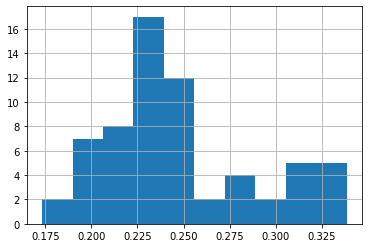

In [ ]:
df_result['val_metric'].hist()

In [ ]:
#best model
df_best = df_result[df_result['val_metric'] == np.max(df_result['val_metric'])]
df_best

,round_epochs,loss,metric,val_loss,val_metric,model_name,activation,optimizer,losses,units,batch_size,epochs
54,15,1.997359,0.383703,2.134726,0.338534,mlpmixer,relu,Adam,crossentropy,128,64,15


In [ ]:
best_model_name = f"cifar100_{df_best['model_name'].values[0]}_{df_best['activation'].values[0]}_{df_best['optimizer'].values[0]}_{df_best['losses'].values[0]}_{df_best['units'].values[0]}_{df_best['batch_size'].values[0]}_{df_best['epochs'].values[0]}.pt"
best_model_name

'cifar100_mlpmixer_relu_Adam_crossentropy_128_64_15.pt'

In [ ]:
class MLPCIFAR(nn.Module, talos.utils.TorchHistory):

        def __init__(self, params):

            super(MLPCIFAR, self).__init__()
            self.model_name =  params['model_name']
            self.act_fun = params['activation']
            
            self.units = params['units']
            if self.model_name == 'mlprgb':
              #activate function
              if self.act_fun == 'relu':
                self.activate = F.relu
              else:
                self.activate = F.gelu
              self.model = MLPRGB(input_dim=32*32*3,output_dim=20, units=self.units, act_fun=self.activate)
            elif self.model_name == 'mlpgray':
              #activate function
              if self.act_fun == 'relu':
                self.activate = F.relu
              else:
                self.activate = F.gelu
              self.model = MLPGRAY(input_dim=32*32*3,output_dim=20, units=self.units, act_fun=self.activate)
            elif self.model_name == 'resmlp':
              #activate function
              if self.act_fun == 'relu':
                self.activate = nn.ReLU()
              else:
                self.activate = nn.GELU()
              self.model = ResMLP(input_dim=32,output_dim=20, act_fun=self.activate)
            else:
              #activate function
              if self.act_fun == 'relu':
                self.activate = nn.ReLU()
              else:
                self.activate = nn.GELU()
              self.model = MLPMixer(input_dim=32,output_dim=20, act_fun=self.activate)

        def forward(self, x):
            x = self.model(x)
            return x

### Inference The Best Model on Test set

In [ ]:
# create model
best_params = {
    'model_name':df_best['model_name'].values[0],
    'activation':df_best['activation'].values[0],
    'units':df_best['units'].values[0]
}

model = MLPCIFAR(best_params)
model.load_state_dict(torch.load(best_model_name))
#optimizer
optimizer = optim.Adam(model.parameters())
#loss function
criterion = nn.CrossEntropyLoss()
#move model to GPU for faster training
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
criterion = criterion.to(device)

In [ ]:
test_loss, test_acc = evaluate(model, test_iterator, criterion, device)
print(f'Test Loss: {test_loss:.3f} | Test Acc: {test_acc*100:.2f}%')

Evaluating:   0%|          | 0/157 [00:00<?, ?it/s]

Test Loss: 2.166 | Test Acc: 33.22%


### Diagnostics The Best Model

In [ ]:
#prediction function
def get_predictions(model, iterator, device):

    model.eval()

    images = []
    labels = []
    probs = []

    with torch.no_grad():

        for (x, y) in iterator:

            x = x.to(device)

            y_pred = model(x)

            y_prob = F.softmax(y_pred, dim=-1)

            images.append(x.cpu())
            labels.append(y.cpu())
            probs.append(y_prob.cpu())

    images = torch.cat(images, dim=0)
    labels = torch.cat(labels, dim=0)
    probs = torch.cat(probs, dim=0)

    return images, labels, probs

In [ ]:
#get predict for test set
images, labels, probs = get_predictions(model, test_iterator, device)

pred_labels = torch.argmax(probs, 1)

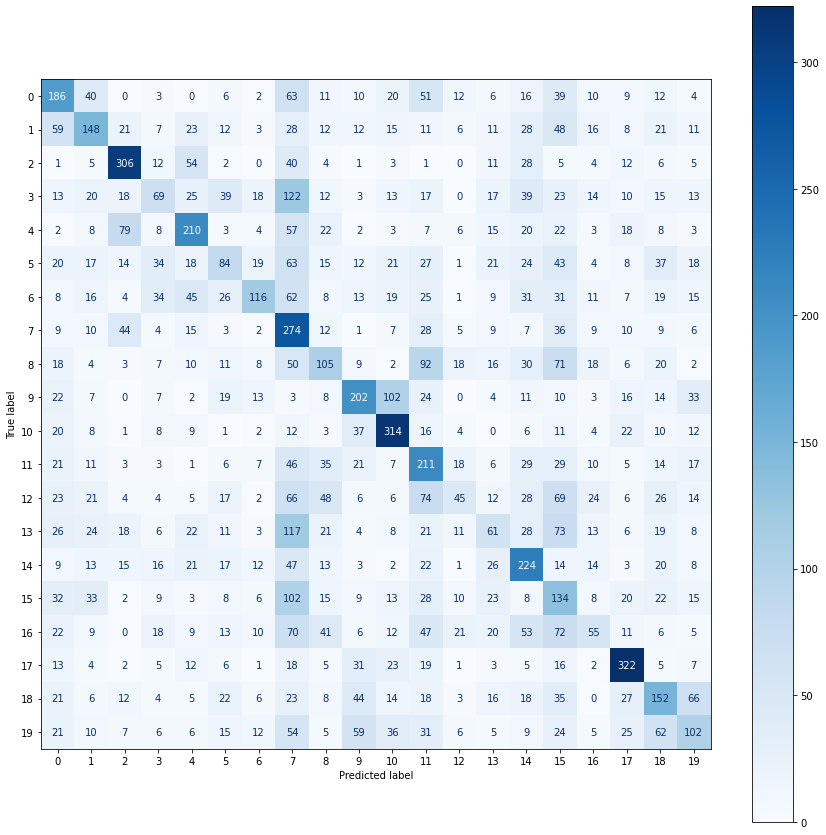

In [ ]:
#plot confusion matrix

def plot_confusion_matrix(labels, pred_labels):

    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(1, 1, 1)
    cm = metrics.confusion_matrix(labels, pred_labels)
    cm = metrics.ConfusionMatrixDisplay(cm, display_labels=range(20))
    cm.plot(values_format='d', cmap='Blues', ax=ax)
#show plot
plot_confusion_matrix(labels, pred_labels)

In [ ]:
#get uncorrect label
corrects = torch.eq(labels, pred_labels)
incorrect_examples = []

for image, label, prob, correct in zip(images, labels, probs, corrects):
    if not correct:
        incorrect_examples.append((image, label, prob))

incorrect_examples.sort(reverse=True,
                        key=lambda x: torch.max(x[2], dim=0).values)
#plot uncorrect label
def plot_most_incorrect(incorrect, n_images):

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure(figsize=(20, 10))
    for i in range(rows*cols):
        ax = fig.add_subplot(rows, cols, i+1)
        image, true_label, probs = incorrect[i]
        true_prob = probs[true_label]
        incorrect_prob, incorrect_label = torch.max(probs, dim=0)
        ax.imshow(image.view(32, 32,3).cpu().numpy(), cmap='bone')
        ax.set_title(f'true label: {true_label} ({true_prob:.3f})\n'
                     f'pred label: {incorrect_label} ({incorrect_prob:.3f})')
        ax.axis('off')
    fig.subplots_adjust(hspace=0.5)

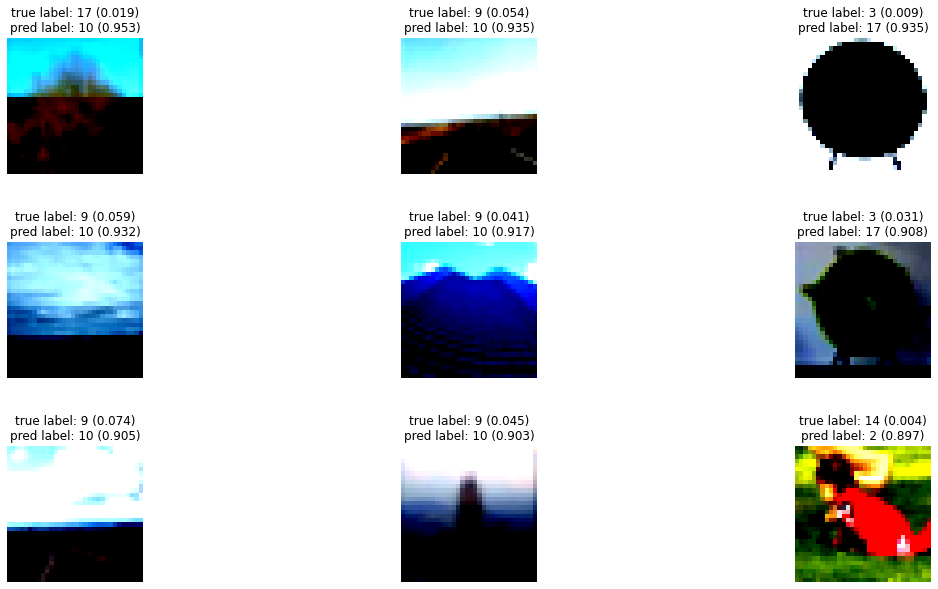

In [ ]:
#show uncorrect image
N_IMAGES = 9

plot_most_incorrect(incorrect_examples, N_IMAGES)